# Introduction

This notebook walks the reader through a full implementation of the original Neural Radiance Field architecture, first introduced by Mildenhall et al. in "[NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis.](https://www.matthewtancik.com/nerf)" For a broader overview, read the accompanying Medium article "[It's NeRF From Nothing: Build A Complete NeRF With Pytorch.](https://medium.com/@masonmcgough/its-nerf-from-nothing-build-a-vanilla-nerf-with-pytorch-7846e4c45666)" This notebook assumes that you have read that article and understand the basics of NeRF.

Much of the code comes from or is inspired by the original implementation by GitHub user [bmild](https://github.com/bmild/nerf) as well as PyTorch implementations from GitHub users [yenchenlin](https://github.com/bmild/nerf) and [krrish94](https://github.com/krrish94/nerf-pytorch/). The code has been modified for clarity and consistency.

## Imports

In [13]:
import os
from typing import Optional, Tuple, List, Union, Callable

import numpy as np
import torch
from torch import nn
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
from tqdm import trange

# For repeatability
# seed = 3407
# torch.manual_seed(seed)
# np.random.seed(seed)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Inputs

## Data

First we load the data which we will train our NeRF model on. This is the Lego bulldozer commonly seen in the NeRF demonstrations and serves as a sort of "Hello World" for training NeRFs. Covering other datasets is outside the scope of this notebook, but feel free to try others included in the original [NeRF source code](https://github.com/bmild/nerf) or your own datasets.

In [14]:
if not os.path.exists('tiny_nerf_data.npz'):
  !wget http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz

--2022-07-08 03:45:22--  http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Resolving cseweb.ucsd.edu (cseweb.ucsd.edu)... 132.239.8.30
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz [following]
--2022-07-08 03:45:22--  https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12727482 (12M)
Saving to: ‘tiny_nerf_data.npz’

tiny_nerf_data.npz  100%[===================>]  12.14M  16.2MB/s    in 0.8s    

2022-07-08 03:45:23 (16.2 MB/s) - ‘tiny_nerf_data.npz’ saved [12727482/12727482]



This dataset consists of 106 images taken of the synthetic Lego bulldozer along with poses and a common focal length value. Like the original, we reserve the first 100 images for training and a single test image for validation.

Images shape: (106, 100, 100, 3)
Poses shape: (106, 4, 4)
Focal length: 138.88887889922103
Pose
[[ 6.8935126e-01  5.3373039e-01 -4.8982298e-01 -1.9745398e+00]
 [-7.2442728e-01  5.0788772e-01 -4.6610624e-01 -1.8789345e+00]
 [ 1.4901163e-08  6.7615211e-01  7.3676193e-01  2.9699826e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]


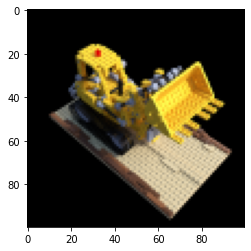

In [15]:
data = np.load('tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']

print(f'Images shape: {images.shape}')
print(f'Poses shape: {poses.shape}')
print(f'Focal length: {focal}')

height, width = images.shape[1:3]
near, far = 2., 6.

n_training = 100
testimg_idx = 101
testimg, testpose = images[testimg_idx], poses[testimg_idx]

plt.imshow(testimg)
print('Pose')
print(testpose)

## Origins and Directions

Recall that NeRF processes inputs from a field of positions (x,y,z) and view directions (θ,φ). To gather these input points, we need to apply inverse rendering to the input images. More concretely, we draw projection lines through each pixel and across the 3D space, from which we can draw samples.

To sample points from the 3D space beyond our image, we first start from the initial pose of every camera taken in the photo set. With some vector math, we can convert these 4x4 pose matrices into a 3D coordinate denoting the origin and a 3D vector indicating the direction. The two together describe a vector that indicates where a camera was pointing when the photo was taken.

The code in the cell below illustrates this by drawing arrows that depict the origin and the direction of every frame.

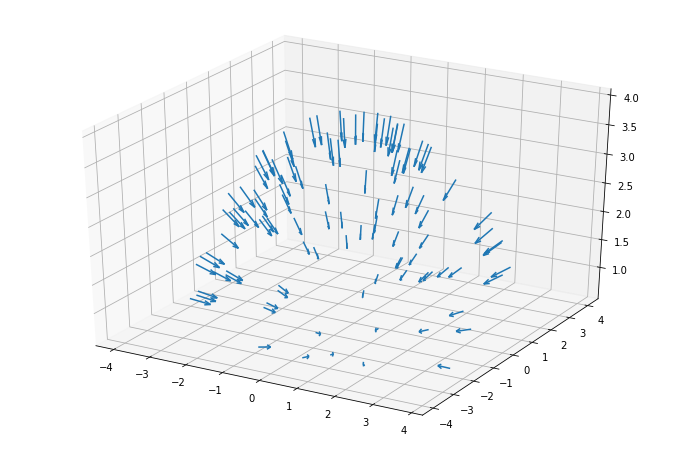

In [16]:
dirs = np.stack([np.sum([0, 0, -1] * pose[:3, :3], axis=-1) for pose in poses])
origins = poses[:, :3, -1]

ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
_ = ax.quiver(
  origins[..., 0].flatten(),
  origins[..., 1].flatten(),
  origins[..., 2].flatten(),
  dirs[..., 0].flatten(),
  dirs[..., 1].flatten(),
  dirs[..., 2].flatten(), length=0.5, normalize=True)
plt.show()

With this camera pose, we can now find the projection lines along each pixel of our image. Each line is defined by its origin point (x,y,z) and its direction (in this case a 3D vector). While the origin is the same for every pixel, the direction is slightly different. These lines are slightly deflected off center such that none of these lines are parallel.

![Pinhole camera](https://www.researchgate.net/profile/Willy-Azarcoya-Cabiedes/publication/317498100/figure/fig10/AS:610418494013440@1522546518034/Pin-hole-camera-model-terminology-The-optical-center-pinhole-is-placed-at-the-origin.png)

From [Willy Azarcoya-Cabiedes via ResearchGate](https://www.researchgate.net/figure/Pin-hole-camera-model-terminology-The-optical-center-pinhole-is-placed-at-the-origin_fig10_317498100)

In [17]:
def get_rays(
  height: int,
  width: int,
  focal_length: float,
  c2w: torch.Tensor
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Find origin and direction of rays through every pixel and camera origin.
  """

  # Apply pinhole camera model to gather directions at each pixel
  i, j = torch.meshgrid(
      torch.arange(width, dtype=torch.float32).to(c2w),
      torch.arange(height, dtype=torch.float32).to(c2w),
      indexing='ij')
  i, j = i.transpose(-1, -2), j.transpose(-1, -2)
  directions = torch.stack([(i - width * .5) / focal_length,
                            -(j - height * .5) / focal_length,
                            -torch.ones_like(i)
                           ], dim=-1)

  # Apply camera pose to directions
  rays_d = torch.sum(directions[..., None, :] * c2w[:3, :3], dim=-1)

  # Origin is same for all directions (the optical center)
  rays_o = c2w[:3, -1].expand(rays_d.shape)
  return rays_o, rays_d

In [18]:
# Gather as torch tensors
images = torch.from_numpy(data['images'][:n_training]).to(device)
poses = torch.from_numpy(data['poses']).to(device)
focal = torch.from_numpy(data['focal']).to(device)
testimg = torch.from_numpy(data['images'][testimg_idx]).to(device)
testpose = torch.from_numpy(data['poses'][testimg_idx]).to(device)

# Grab rays from sample image
height, width = images.shape[1:3]
with torch.no_grad():
  ray_origin, ray_direction = get_rays(height, width, focal, testpose)

print('Ray Origin')
print(ray_origin.shape)
print(ray_origin[height // 2, width // 2, :])
print('')

print('Ray Direction')
print(ray_direction.shape)
print(ray_direction[height // 2, width // 2, :])
print('')

Ray Origin
torch.Size([100, 100, 3])
tensor([-1.9745, -1.8789,  2.9700], device='cuda:0')

Ray Direction
torch.Size([100, 100, 3])
tensor([ 0.4898,  0.4661, -0.7368], device='cuda:0')



# Architecture

## Stratified Sampling

Now that we have these lines, defined as origin and direction vectors, we can begin the process of sampling them. Recall that NeRF takes a coarse-to-fine sampling strategy, starting with the stratified sampling approach.

The stratified sampling approach splits the ray into evenly-spaced bins and randomly samples within each bin. The `perturb` setting determines whether to sample points uniformly from each bin or to simply use the bin center as the point. In most cases, we want to keep `perturb = True` as it will encourage the network to learn over a continuously sampled space. It may be useful to disable for debugging.

In [19]:
def sample_stratified(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  n_samples: int,
  perturb: Optional[bool] = True,
  inverse_depth: bool = False
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Sample along ray from regularly-spaced bins.
  """

  # Grab samples for space integration along ray
  t_vals = torch.linspace(0., 1., n_samples, device=rays_o.device)
  if not inverse_depth:
    # Sample linearly between `near` and `far`
    z_vals = near * (1.-t_vals) + far * (t_vals)
  else:
    # Sample linearly in inverse depth (disparity)
    z_vals = 1./(1./near * (1.-t_vals) + 1./far * (t_vals))

  # Draw uniform samples from bins along ray
  if perturb:
    mids = .5 * (z_vals[1:] + z_vals[:-1])
    upper = torch.concat([mids, z_vals[-1:]], dim=-1)
    lower = torch.concat([z_vals[:1], mids], dim=-1)
    t_rand = torch.rand([n_samples], device=z_vals.device)
    z_vals = lower + (upper - lower) * t_rand
  z_vals = z_vals.expand(list(rays_o.shape[:-1]) + [n_samples])

  # Apply scale from `rays_d` and offset from `rays_o` to samples
  # pts: (width, height, n_samples, 3)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals[..., :, None]
  return pts, z_vals

In [20]:
# Draw stratified samples from example
rays_o = ray_origin.view([-1, 3])
rays_d = ray_direction.view([-1, 3])
n_samples = 8
perturb = True
inverse_depth = False
with torch.no_grad():
  pts, z_vals = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=perturb, inverse_depth=inverse_depth)

print('Input Points')
print(pts.shape)
print('')
print('Distances Along Ray')
print(z_vals.shape)

Input Points
torch.Size([10000, 8, 3])

Distances Along Ray
torch.Size([10000, 8])


Now we visualize these sampled points. The unperturbed blue points are the bin "centers." The red points are a sampling of perturbed points. Notice how the red points are slightly offset from the blue points above them, but all are constrained between `near` and `far`.

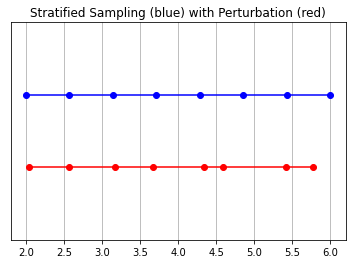

In [21]:
y_vals = torch.zeros_like(z_vals)

_, z_vals_unperturbed = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=False, inverse_depth=inverse_depth)
plt.plot(z_vals_unperturbed[0].cpu().numpy(), 1 + y_vals[0].cpu().numpy(), 'b-o')
plt.plot(z_vals[0].cpu().numpy(), y_vals[0].cpu().numpy(), 'r-o')
plt.ylim([-1, 2])
plt.title('Stratified Sampling (blue) with Perturbation (red)')
ax = plt.gca()
ax.axes.yaxis.set_visible(False)
plt.grid(True)

## Positional Encoder

Much like Transformers, NeRFs make use of positional encoders. In this case, it's to map the inputs to a higher frequency space to compensate for the bias that neural networks have for learning lower-frequency functions.

Here we build a simple `torch.nn.Module` of our positional encoder. The same encoder implementation can be applied to both input samples and view directions. However, we choose different parameters for these inputs. We use the default settings from the original.

In [22]:
class PositionalEncoder(nn.Module):
  r"""
  Sine-cosine positional encoder for input points.
  """
  def __init__(
    self,
    d_input: int,
    n_freqs: int,
    log_space: bool = False
  ):
    super().__init__()
    self.d_input = d_input
    self.n_freqs = n_freqs
    self.log_space = log_space
    self.d_output = d_input * (1 + 2 * self.n_freqs)
    self.embed_fns = [lambda x: x]

    # Define frequencies in either linear or log scale
    if self.log_space:
      freq_bands = 2.**torch.linspace(0., self.n_freqs - 1, self.n_freqs)
    else:
      freq_bands = torch.linspace(2.**0., 2.**(self.n_freqs - 1), self.n_freqs)

    # Alternate sin and cos
    for freq in freq_bands:
      self.embed_fns.append(lambda x, freq=freq: torch.sin(x * freq))
      self.embed_fns.append(lambda x, freq=freq: torch.cos(x * freq))
  
  def forward(
    self,
    x
  ) -> torch.Tensor:
    r"""
    Apply positional encoding to input.
    """
    return torch.concat([fn(x) for fn in self.embed_fns], dim=-1)


In [23]:
# Create encoders for points and view directions
encoder = PositionalEncoder(3, 10)
viewdirs_encoder = PositionalEncoder(3, 4)

# Grab flattened points and view directions
pts_flattened = pts.reshape(-1, 3)
viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
flattened_viewdirs = viewdirs[:, None, ...].expand(pts.shape).reshape((-1, 3))

# Encode inputs
encoded_points = encoder(pts_flattened)
encoded_viewdirs = viewdirs_encoder(flattened_viewdirs)

print('Encoded Points')
print(encoded_points.shape)
print(torch.min(encoded_points), torch.max(encoded_points), torch.mean(encoded_points))
print('')

print(encoded_viewdirs.shape)
print('Encoded Viewdirs')
print(torch.min(encoded_viewdirs), torch.max(encoded_viewdirs), torch.mean(encoded_viewdirs))
print('')

Encoded Points
torch.Size([80000, 63])
tensor(-2.6610, device='cuda:0') tensor(3.3735, device='cuda:0') tensor(0.0263, device='cuda:0')

torch.Size([80000, 27])
Encoded Viewdirs
tensor(-1., device='cuda:0') tensor(1., device='cuda:0') tensor(0.1056, device='cuda:0')



## NeRF Model

Here we define the NeRF model, which consists primarily of a `ModuleList` of `Linear` layers, separated by non-linear activation functions and the occasional residual connection. This model features an optional input for view directions, which will alter the model architecture if provided at instantiation. This implementation is based on Section 3 of the original "NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis" paper and uses the same defaults.

In [24]:
class NeRF(nn.Module):
  r"""
  Neural radiance fields module.
  """
  def __init__(
    self,
    d_input: int = 3,
    n_layers: int = 8,
    d_filter: int = 256,
    skip: Tuple[int] = (4,),
    d_viewdirs: Optional[int] = None
  ):
    super().__init__()
    self.d_input = d_input
    self.skip = skip
    self.act = nn.functional.relu
    self.d_viewdirs = d_viewdirs

    # Create model layers
    self.layers = nn.ModuleList(
      [nn.Linear(self.d_input, d_filter)] +
      [nn.Linear(d_filter + self.d_input, d_filter) if i in skip \
       else nn.Linear(d_filter, d_filter) for i in range(n_layers - 1)]
    )

    # Bottleneck layers
    if self.d_viewdirs is not None:
      # If using viewdirs, split alpha and RGB
      self.alpha_out = nn.Linear(d_filter, 1)
      self.rgb_filters = nn.Linear(d_filter, d_filter)
      self.branch = nn.Linear(d_filter + self.d_viewdirs, d_filter // 2)
      self.output = nn.Linear(d_filter // 2, 3)
    else:
      # If no viewdirs, use simpler output
      self.output = nn.Linear(d_filter, 4)
  
  def forward(
    self,
    x: torch.Tensor,
    viewdirs: Optional[torch.Tensor] = None
  ) -> torch.Tensor:
    r"""
    Forward pass with optional view direction.
    """

    # Cannot use viewdirs if instantiated with d_viewdirs = None
    if self.d_viewdirs is None and viewdirs is not None:
      raise ValueError('Cannot input x_direction if d_viewdirs was not given.')

    # Apply forward pass up to bottleneck
    x_input = x
    for i, layer in enumerate(self.layers):
      x = self.act(layer(x))
      if i in self.skip:
        x = torch.cat([x, x_input], dim=-1)

    # Apply bottleneck
    if self.d_viewdirs is not None:
      # Split alpha from network output
      alpha = self.alpha_out(x)

      # Pass through bottleneck to get RGB
      x = self.rgb_filters(x)
      x = torch.concat([x, viewdirs], dim=-1)
      x = self.act(self.branch(x))
      x = self.output(x)

      # Concatenate alphas to output
      x = torch.concat([x, alpha], dim=-1)
    else:
      # Simple output
      x = self.output(x)
    return x

## Volume Rendering

From the raw NeRF outputs, we still need to convert these into an image. This is where we apply the volume integration described in Equations 1-3 in Section 4 of the paper. Essentially, we take the weighted sum of all samples along the ray of each pixel to get the estimated color value at that pixel. Each RGB sample is weighted by its alpha value. Higher alpha values indicate higher likelihood that the sampled area is opaque, therefore points further along the ray are likelier to be occluded. The cumulative product ensures that those further points are dampened.

In [25]:
def cumprod_exclusive(
  tensor: torch.Tensor
) -> torch.Tensor:
  r"""
  (Courtesy of https://github.com/krrish94/nerf-pytorch)

  Mimick functionality of tf.math.cumprod(..., exclusive=True), as it isn't available in PyTorch.

  Args:
  tensor (torch.Tensor): Tensor whose cumprod (cumulative product, see `torch.cumprod`) along dim=-1
    is to be computed.
  Returns:
  cumprod (torch.Tensor): cumprod of Tensor along dim=-1, mimiciking the functionality of
    tf.math.cumprod(..., exclusive=True) (see `tf.math.cumprod` for details).
  """

  # Compute regular cumprod first (this is equivalent to `tf.math.cumprod(..., exclusive=False)`).
  cumprod = torch.cumprod(tensor, -1)
  # "Roll" the elements along dimension 'dim' by 1 element.
  cumprod = torch.roll(cumprod, 1, -1)
  # Replace the first element by "1" as this is what tf.cumprod(..., exclusive=True) does.
  cumprod[..., 0] = 1.
  
  return cumprod

def raw2outputs(
  raw: torch.Tensor,
  z_vals: torch.Tensor,
  rays_d: torch.Tensor,
  raw_noise_std: float = 0.0,
  white_bkgd: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Convert the raw NeRF output into RGB and other maps.
  """

  # Difference between consecutive elements of `z_vals`. [n_rays, n_samples]
  dists = z_vals[..., 1:] - z_vals[..., :-1]
  dists = torch.cat([dists, 1e10 * torch.ones_like(dists[..., :1])], dim=-1)

  # Multiply each distance by the norm of its corresponding direction ray
  # to convert to real world distance (accounts for non-unit directions).
  dists = dists * torch.norm(rays_d[..., None, :], dim=-1)

  # Add noise to model's predictions for density. Can be used to 
  # regularize network during training (prevents floater artifacts).
  noise = 0.
  if raw_noise_std > 0.:
    noise = torch.randn(raw[..., 3].shape) * raw_noise_std

  # Predict density of each sample along each ray. Higher values imply
  # higher likelihood of being absorbed at this point. [n_rays, n_samples]
  alpha = 1.0 - torch.exp(-nn.functional.relu(raw[..., 3] + noise) * dists)

  # Compute weight for RGB of each sample along each ray. [n_rays, n_samples]
  # The higher the alpha, the lower subsequent weights are driven.
  weights = alpha * cumprod_exclusive(1. - alpha + 1e-10)

  # Compute weighted RGB map.
  rgb = torch.sigmoid(raw[..., :3])  # [n_rays, n_samples, 3]
  rgb_map = torch.sum(weights[..., None] * rgb, dim=-2)  # [n_rays, 3]

  # Estimated depth map is predicted distance.
  depth_map = torch.sum(weights * z_vals, dim=-1)

  # Disparity map is inverse depth.
  disp_map = 1. / torch.max(1e-10 * torch.ones_like(depth_map),
                            depth_map / torch.sum(weights, -1))

  # Sum of weights along each ray. In [0, 1] up to numerical error.
  acc_map = torch.sum(weights, dim=-1)

  # To composite onto a white background, use the accumulated alpha map.
  if white_bkgd:
    rgb_map = rgb_map + (1. - acc_map[..., None])

  return rgb_map, depth_map, acc_map, weights

## Hierarchical Volume Sampling

The 3D space is in fact very sparse with occlusions and so most points don't contribute much to the rendered image. It is therefore more beneficial to oversample regions with a high likelihood of contributing to the integral. Here we apply learned, normalized weights to the first set of samples to create a PDF across the ray, then apply inverse transform sampling to this PDF to gather a second set of samples.

In [26]:
def sample_pdf(
  bins: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> torch.Tensor:
  r"""
  Apply inverse transform sampling to a weighted set of points.
  """

  # Normalize weights to get PDF.
  pdf = (weights + 1e-5) / torch.sum(weights + 1e-5, -1, keepdims=True) # [n_rays, weights.shape[-1]]

  # Convert PDF to CDF.
  cdf = torch.cumsum(pdf, dim=-1) # [n_rays, weights.shape[-1]]
  cdf = torch.concat([torch.zeros_like(cdf[..., :1]), cdf], dim=-1) # [n_rays, weights.shape[-1] + 1]

  # Take sample positions to grab from CDF. Linear when perturb == 0.
  if not perturb:
    u = torch.linspace(0., 1., n_samples, device=cdf.device)
    u = u.expand(list(cdf.shape[:-1]) + [n_samples]) # [n_rays, n_samples]
  else:
    u = torch.rand(list(cdf.shape[:-1]) + [n_samples], device=cdf.device) # [n_rays, n_samples]

  # Find indices along CDF where values in u would be placed.
  u = u.contiguous() # Returns contiguous tensor with same values.
  inds = torch.searchsorted(cdf, u, right=True) # [n_rays, n_samples]

  # Clamp indices that are out of bounds.
  below = torch.clamp(inds - 1, min=0)
  above = torch.clamp(inds, max=cdf.shape[-1] - 1)
  inds_g = torch.stack([below, above], dim=-1) # [n_rays, n_samples, 2]

  # Sample from cdf and the corresponding bin centers.
  matched_shape = list(inds_g.shape[:-1]) + [cdf.shape[-1]]
  cdf_g = torch.gather(cdf.unsqueeze(-2).expand(matched_shape), dim=-1,
                       index=inds_g)
  bins_g = torch.gather(bins.unsqueeze(-2).expand(matched_shape), dim=-1,
                        index=inds_g)

  # Convert samples to ray length.
  denom = (cdf_g[..., 1] - cdf_g[..., 0])
  denom = torch.where(denom < 1e-5, torch.ones_like(denom), denom)
  t = (u - cdf_g[..., 0]) / denom
  samples = bins_g[..., 0] + t * (bins_g[..., 1] - bins_g[..., 0])

  return samples # [n_rays, n_samples]

In [27]:
def sample_hierarchical(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  z_vals: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Apply hierarchical sampling to the rays.
  """

  # Draw samples from PDF using z_vals as bins and weights as probabilities.
  z_vals_mid = .5 * (z_vals[..., 1:] + z_vals[..., :-1])
  new_z_samples = sample_pdf(z_vals_mid, weights[..., 1:-1], n_samples,
                          perturb=perturb)
  new_z_samples = new_z_samples.detach()

  # Resample points from ray based on PDF.
  z_vals_combined, _ = torch.sort(torch.cat([z_vals, new_z_samples], dim=-1), dim=-1)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals_combined[..., :, None]  # [N_rays, N_samples + n_samples, 3]
  return pts, z_vals_combined, new_z_samples

## Full Forward Pass

Here is where we put everything together to compute a single forward pass through our model.

Due to potential memory issues, the forward pass is computed in "chunks," which are then aggregated across a single batch. The gradient propagation is done after the whole batch is processed, hence the distinction between "chunks" and "batches." Chunking is especially important for the Google Colab environment, which provides more modest resources than those cited in the original paper.

In [28]:
def get_chunks(
  inputs: torch.Tensor,
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Divide an input into chunks.
  """
  return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

def prepare_chunks(
  points: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify points to prepare for NeRF model.
  """
  points = points.reshape((-1, 3))
  points = encoding_function(points)
  points = get_chunks(points, chunksize=chunksize)
  return points

def prepare_viewdirs_chunks(
  points: torch.Tensor,
  rays_d: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify viewdirs to prepare for NeRF model.
  """
  # Prepare the viewdirs
  viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
  viewdirs = viewdirs[:, None, ...].expand(points.shape).reshape((-1, 3))
  viewdirs = encoding_function(viewdirs)
  viewdirs = get_chunks(viewdirs, chunksize=chunksize)
  return viewdirs

In [30]:
def nerf_forward(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  encoding_fn: Callable[[torch.Tensor], torch.Tensor],
  coarse_model: nn.Module,
  kwargs_sample_stratified: dict = None,
  n_samples_hierarchical: int = 0,
  kwargs_sample_hierarchical: dict = None,
  fine_model = None,
  viewdirs_encoding_fn: Optional[Callable[[torch.Tensor], torch.Tensor]] = None,
  chunksize: int = 2**15
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, dict]:
  r"""
  Compute forward pass through model(s).
  """

  # Set no kwargs if none are given.
  if kwargs_sample_stratified is None:
    kwargs_sample_stratified = {}
  if kwargs_sample_hierarchical is None:
    kwargs_sample_hierarchical = {}
  
  # Sample query points along each ray.
  query_points, z_vals = sample_stratified(
      rays_o, rays_d, near, far, **kwargs_sample_stratified)

  # Prepare batches.
  batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
  if viewdirs_encoding_fn is not None:
    batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                               viewdirs_encoding_fn,
                                               chunksize=chunksize)
  else:
    batches_viewdirs = [None] * len(batches)

  # Coarse model pass.
  # Split the encoded points into "chunks", run the model on all chunks, and
  # concatenate the results (to avoid out-of-memory issues).
  predictions = []
  for batch, batch_viewdirs in zip(batches, batches_viewdirs):
    predictions.append(coarse_model(batch, viewdirs=batch_viewdirs))
  raw = torch.cat(predictions, dim=0)
  raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

  # Perform differentiable volume rendering to re-synthesize the RGB image.
  rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals, rays_d)
  # rgb_map, depth_map, acc_map, weights = render_volume_density(raw, rays_o, z_vals)
  outputs = {
      'z_vals_stratified': z_vals
  }

  # Fine model pass.
  if n_samples_hierarchical > 0:
    # Save previous outputs to return.
    rgb_map_0, depth_map_0, acc_map_0 = rgb_map, depth_map, acc_map

    # Apply hierarchical sampling for fine query points.
    query_points, z_vals_combined, z_hierarch = sample_hierarchical(
      rays_o, rays_d, z_vals, weights, n_samples_hierarchical,
      **kwargs_sample_hierarchical)

    # Prepare inputs as before.
    batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
    if viewdirs_encoding_fn is not None:
      batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                                 viewdirs_encoding_fn,
                                                 chunksize=chunksize)
    else:
      batches_viewdirs = [None] * len(batches)

    # Forward pass new samples through fine model.
    fine_model = fine_model if fine_model is not None else coarse_model
    predictions = []
    for batch, batch_viewdirs in zip(batches, batches_viewdirs):
      predictions.append(fine_model(batch, viewdirs=batch_viewdirs))
    raw = torch.cat(predictions, dim=0)
    raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

    # Perform differentiable volume rendering to re-synthesize the RGB image.
    rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals_combined, rays_d)
    
    # Store outputs.
    outputs['z_vals_hierarchical'] = z_hierarch
    outputs['rgb_map_0'] = rgb_map_0
    outputs['depth_map_0'] = depth_map_0
    outputs['acc_map_0'] = acc_map_0

  # Store outputs.
  outputs['rgb_map'] = rgb_map
  outputs['depth_map'] = depth_map
  outputs['acc_map'] = acc_map
  outputs['weights'] = weights
  return outputs

# Train

At long last, we have (almost) everything we need to train the model. Now we will do some setup for a simple training procedure, creating hyperparameters and helper functions, then train our model.

## Hyperparameters

All hyperparameters for training are set here. Defaults were taken from the original, unless computational constraints prohibit them. In this case, we apply sensible defaults that are well within the resources provided by Google Colab.

In [31]:
# Encoders
d_input = 3           # Number of input dimensions
n_freqs = 10          # Number of encoding functions for samples
log_space = True      # If set, frequencies scale in log space
use_viewdirs = True   # If set, use view direction as input
n_freqs_views = 4     # Number of encoding functions for views

# Stratified sampling
n_samples = 64         # Number of spatial samples per ray
perturb = True         # If set, applies noise to sample positions
inverse_depth = False  # If set, samples points linearly in inverse depth

# Model
d_filter = 128          # Dimensions of linear layer filters
n_layers = 2            # Number of layers in network bottleneck
skip = []               # Layers at which to apply input residual
use_fine_model = True   # If set, creates a fine model
d_filter_fine = 128     # Dimensions of linear layer filters of fine network
n_layers_fine = 6       # Number of layers in fine network bottleneck

# Hierarchical sampling
n_samples_hierarchical = 64   # Number of samples per ray
perturb_hierarchical = False  # If set, applies noise to sample positions

# Optimizer
lr = 5e-4  # Learning rate

# Training
n_iters = 10000
batch_size = 2**14          # Number of rays per gradient step (power of 2)
one_image_per_step = True   # One image per gradient step (disables batching)
chunksize = 2**14           # Modify as needed to fit in GPU memory
center_crop = True          # Crop the center of image (one_image_per_)
center_crop_iters = 50      # Stop cropping center after this many epochs
display_rate = 25          # Display test output every X epochs

# Early Stopping
warmup_iters = 100          # Number of iterations during warmup phase
warmup_min_fitness = 10.0   # Min val PSNR to continue training at warmup_iters
n_restarts = 10             # Number of times to restart if training stalls

# We bundle the kwargs for various functions to pass all at once.
kwargs_sample_stratified = {
    'n_samples': n_samples,
    'perturb': perturb,
    'inverse_depth': inverse_depth
}
kwargs_sample_hierarchical = {
    'perturb': perturb
}

## Training Classes and Functions

Here we create some helper functions for training. NeRF can be prone to local minima, in which training will quickly stall and produce blank outputs. `EarlyStopping` is used to restart the training when learning stalls, if necessary.

In [33]:
def plot_samples(
  z_vals: torch.Tensor,
  z_hierarch: Optional[torch.Tensor] = None,
  ax: Optional[np.ndarray] = None):
  r"""
  Plot stratified and (optional) hierarchical samples.
  """
  y_vals = 1 + np.zeros_like(z_vals)

  if ax is None:
    ax = plt.subplot()
  ax.plot(z_vals, y_vals, 'b-o')
  if z_hierarch is not None:
    y_hierarch = np.zeros_like(z_hierarch)
    ax.plot(z_hierarch, y_hierarch, 'r-o')
  ax.set_ylim([-1, 2])
  ax.set_title('Stratified  Samples (blue) and Hierarchical Samples (red)')
  ax.axes.yaxis.set_visible(False)
  ax.grid(True)
  return ax

def crop_center(
  img: torch.Tensor,
  frac: float = 0.5
) -> torch.Tensor:
  r"""
  Crop center square from image.
  """
  h_offset = round(img.shape[0] * (frac / 2))
  w_offset = round(img.shape[1] * (frac / 2))
  return img[h_offset:-h_offset, w_offset:-w_offset]

class EarlyStopping:
  r"""
  Early stopping helper based on fitness criterion.
  """
  def __init__(
    self,
    patience: int = 30,
    margin: float = 1e-4
  ):
    self.best_fitness = 0.0  # In our case PSNR
    self.best_iter = 0
    self.margin = margin
    self.patience = patience or float('inf')  # epochs to wait after fitness stops improving to stop

  def __call__(
    self,
    iter: int,
    fitness: float
  ):
    r"""
    Check if criterion for stopping is met.
    """
    if (fitness - self.best_fitness) > self.margin:
      self.best_iter = iter
      self.best_fitness = fitness
    delta = iter - self.best_iter
    stop = delta >= self.patience  # stop training if patience exceeded
    return stop

In [34]:
def init_models():
  r"""
  Initialize models, encoders, and optimizer for NeRF training.
  """
  # Encoders
  encoder = PositionalEncoder(d_input, n_freqs, log_space=log_space)
  encode = lambda x: encoder(x)

  # View direction encoders
  if use_viewdirs:
    encoder_viewdirs = PositionalEncoder(d_input, n_freqs_views,
                                        log_space=log_space)
    encode_viewdirs = lambda x: encoder_viewdirs(x)
    d_viewdirs = encoder_viewdirs.d_output
  else:
    encode_viewdirs = None
    d_viewdirs = None

  # Models
  model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
              d_viewdirs=d_viewdirs)
  model.to(device)
  model_params = list(model.parameters())
  if use_fine_model:
    fine_model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
                      d_viewdirs=d_viewdirs)
    fine_model.to(device)
    model_params = model_params + list(fine_model.parameters())
  else:
    fine_model = None

  # Optimizer
  optimizer = torch.optim.Adam(model_params, lr=lr)

  # Early Stopping
  warmup_stopper = EarlyStopping(patience=50)

  return model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper

## Training Loop

Here we start training our model. 

In [35]:
def train():
  r"""
  Launch training session for NeRF.
  """
  # Shuffle rays across all images.
  if not one_image_per_step:
    height, width = images.shape[1:3]
    all_rays = torch.stack([torch.stack(get_rays(height, width, focal, p), 0)
                        for p in poses[:n_training]], 0)
    rays_rgb = torch.cat([all_rays, images[:, None]], 1)
    rays_rgb = torch.permute(rays_rgb, [0, 2, 3, 1, 4])
    rays_rgb = rays_rgb.reshape([-1, 3, 3])
    rays_rgb = rays_rgb.type(torch.float32)
    rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
    i_batch = 0

  train_psnrs = []
  val_psnrs = []
  iternums = []
  for i in trange(n_iters):
    model.train()

    if one_image_per_step:
      # Randomly pick an image as the target.
      target_img_idx = np.random.randint(images.shape[0])
      target_img = images[target_img_idx].to(device)
      if center_crop and i < center_crop_iters:
        target_img = crop_center(target_img)
      height, width = target_img.shape[:2]
      target_pose = poses[target_img_idx].to(device)
      rays_o, rays_d = get_rays(height, width, focal, target_pose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
    else:
      # Random over all images.
      batch = rays_rgb[i_batch:i_batch + batch_size]
      batch = torch.transpose(batch, 0, 1)
      rays_o, rays_d, target_img = batch
      height, width = target_img.shape[:2]
      i_batch += batch_size
      # Shuffle after one epoch
      if i_batch >= rays_rgb.shape[0]:
          rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
          i_batch = 0
    target_img = target_img.reshape([-1, 3])

    # Run one iteration of TinyNeRF and get the rendered RGB image.
    outputs = nerf_forward(rays_o, rays_d,
                           near, far, encode, model,
                           kwargs_sample_stratified=kwargs_sample_stratified,
                           n_samples_hierarchical=n_samples_hierarchical,
                           kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                           fine_model=fine_model,
                           viewdirs_encoding_fn=encode_viewdirs,
                           chunksize=chunksize)
    
    # Check for any numerical issues.
    for k, v in outputs.items():
      if torch.isnan(v).any():
        print(f"! [Numerical Alert] {k} contains NaN.")
      if torch.isinf(v).any():
        print(f"! [Numerical Alert] {k} contains Inf.")

    # Backprop!
    rgb_predicted = outputs['rgb_map']
    loss = torch.nn.functional.mse_loss(rgb_predicted, target_img)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()

    # Compute mean-squared error between predicted and target images.
    psnr = -10. * torch.log10(loss)
    train_psnrs.append(psnr.item())

    # Evaluate testimg at given display rate.
    if i % display_rate == 0:
      model.eval()
      height, width = testimg.shape[:2]
      rays_o, rays_d = get_rays(height, width, focal, testpose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
      outputs = nerf_forward(rays_o, rays_d,
                             near, far, encode, model,
                             kwargs_sample_stratified=kwargs_sample_stratified,
                             n_samples_hierarchical=n_samples_hierarchical,
                             kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                             fine_model=fine_model,
                             viewdirs_encoding_fn=encode_viewdirs,
                             chunksize=chunksize)

      rgb_predicted = outputs['rgb_map']
      loss = torch.nn.functional.mse_loss(rgb_predicted, testimg.reshape(-1, 3))
      print("Loss:", loss.item())
      val_psnr = -10. * torch.log10(loss)
      
      val_psnrs.append(val_psnr.item())
      iternums.append(i)

      # Plot example outputs
      fig, ax = plt.subplots(1, 4, figsize=(24,4), gridspec_kw={'width_ratios': [1, 1, 1, 3]})
      ax[0].imshow(rgb_predicted.reshape([height, width, 3]).detach().cpu().numpy())
      ax[0].set_title(f'Iteration: {i}')
      ax[1].imshow(testimg.detach().cpu().numpy())
      ax[1].set_title(f'Target')
      ax[2].plot(range(0, i + 1), train_psnrs, 'r')
      ax[2].plot(iternums, val_psnrs, 'b')
      ax[2].set_title('PSNR (train=red, val=blue')
      z_vals_strat = outputs['z_vals_stratified'].view((-1, n_samples))
      z_sample_strat = z_vals_strat[z_vals_strat.shape[0] // 2].detach().cpu().numpy()
      if 'z_vals_hierarchical' in outputs:
        z_vals_hierarch = outputs['z_vals_hierarchical'].view((-1, n_samples_hierarchical))
        z_sample_hierarch = z_vals_hierarch[z_vals_hierarch.shape[0] // 2].detach().cpu().numpy()
      else:
        z_sample_hierarch = None
      _ = plot_samples(z_sample_strat, z_sample_hierarch, ax=ax[3])
      ax[3].margins(0)
      plt.show()

    # Check PSNR for issues and stop if any are found.
    if i == warmup_iters - 1:
      if val_psnr < warmup_min_fitness:
        print(f'Val PSNR {val_psnr} below warmup_min_fitness {warmup_min_fitness}. Stopping...')
        return False, train_psnrs, val_psnrs
    elif i < warmup_iters:
      if warmup_stopper is not None and warmup_stopper(i, psnr):
        print(f'Train PSNR flatlined at {psnr} for {warmup_stopper.patience} iters. Stopping...')
        return False, train_psnrs, val_psnrs
    
  return True, train_psnrs, val_psnrs

  0%|          | 0/10000 [00:00<?, ?it/s]

Loss: 0.16878801584243774


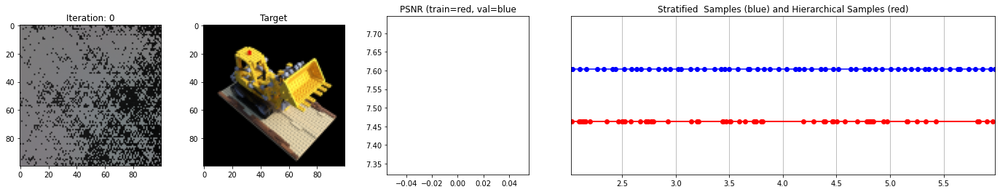

  0%|          | 25/10000 [00:02<14:15, 11.66it/s]

Loss: 0.12984345853328705


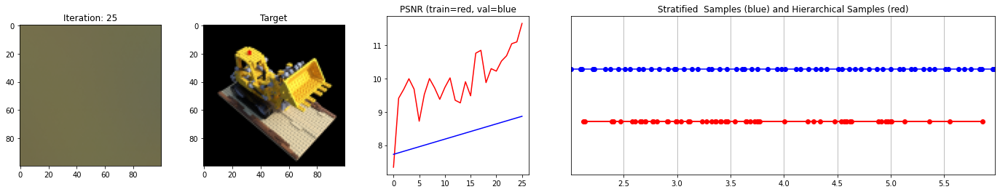

  0%|          | 49/10000 [00:05<14:18, 11.59it/s]

Loss: 0.10193806886672974


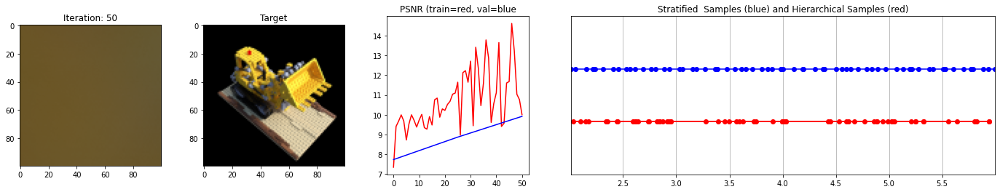

  1%|          | 75/10000 [00:14<55:36,  2.97it/s]

Loss: 0.08493553102016449


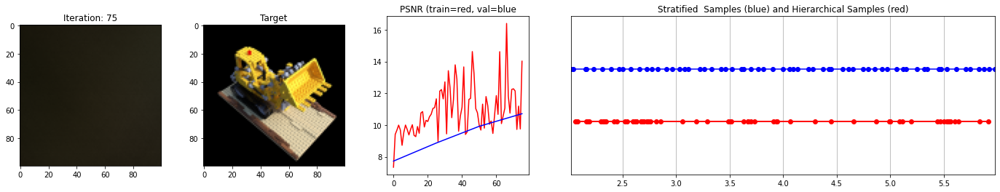

  1%|          | 100/10000 [00:23<55:57,  2.95it/s]

Loss: 0.07846129685640335


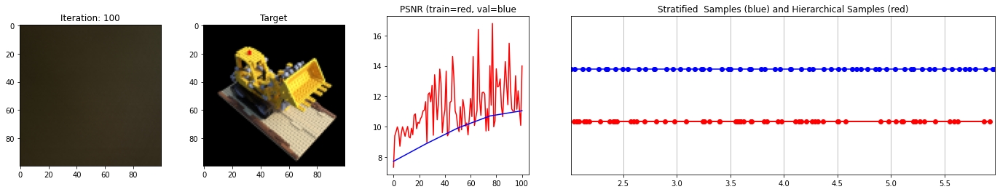

  1%|▏         | 125/10000 [00:33<55:38,  2.96it/s]

Loss: 0.0771503746509552


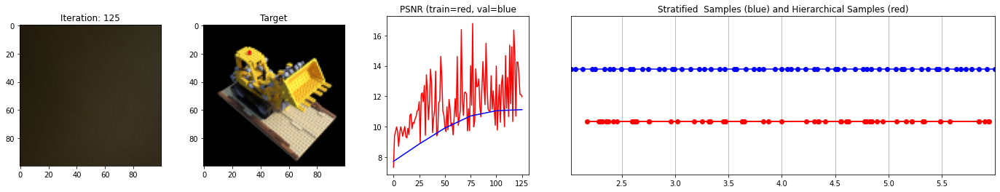

  2%|▏         | 150/10000 [00:42<55:45,  2.94it/s]

Loss: 0.07559133321046829


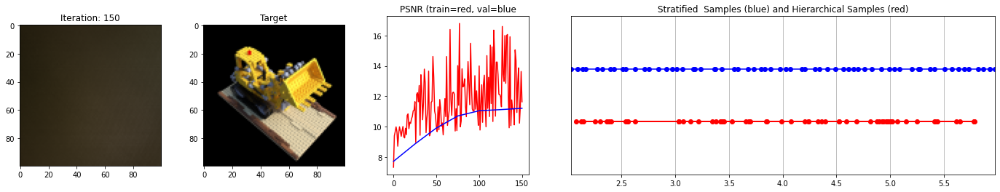

  2%|▏         | 175/10000 [00:51<56:26,  2.90it/s]

Loss: 0.07408090680837631


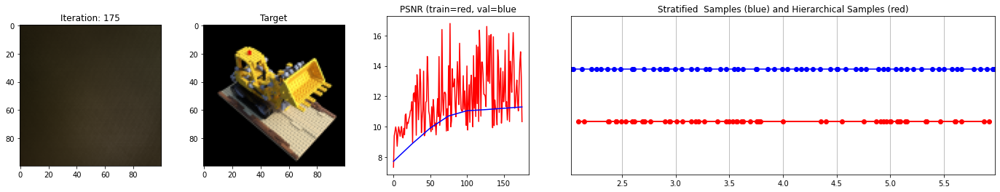

  2%|▏         | 200/10000 [01:00<56:00,  2.92it/s]

Loss: 0.07097997516393661


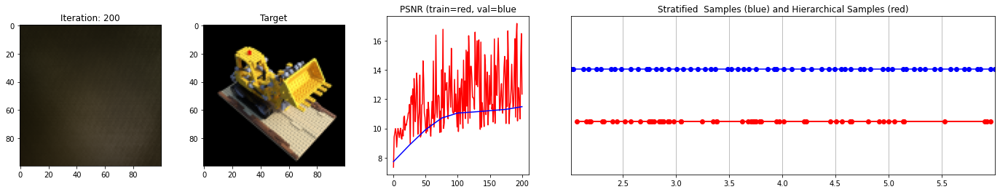

  2%|▏         | 225/10000 [01:10<55:35,  2.93it/s]

Loss: 0.06396790593862534


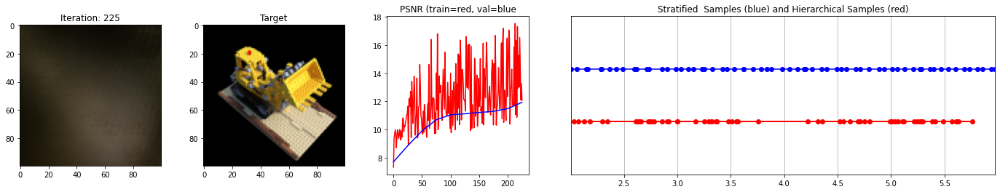

  2%|▎         | 250/10000 [01:19<55:26,  2.93it/s]

Loss: 0.04765961319208145


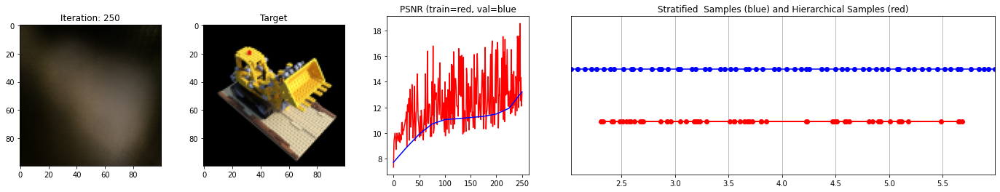

  3%|▎         | 275/10000 [01:28<55:12,  2.94it/s]

Loss: 0.035254739224910736


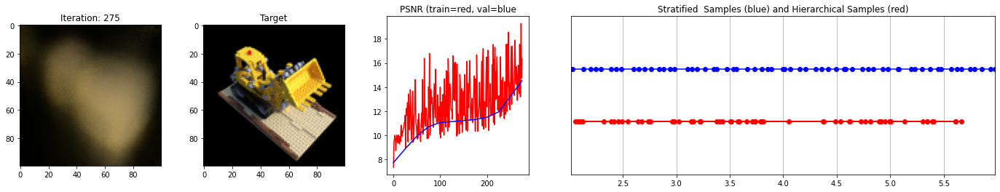

  3%|▎         | 300/10000 [01:37<55:13,  2.93it/s]

Loss: 0.03262639045715332


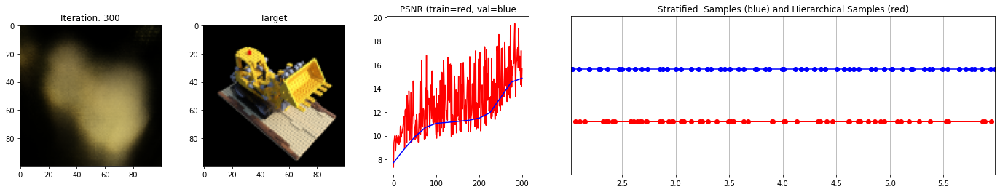

  3%|▎         | 325/10000 [01:46<55:07,  2.93it/s]

Loss: 0.031849779188632965


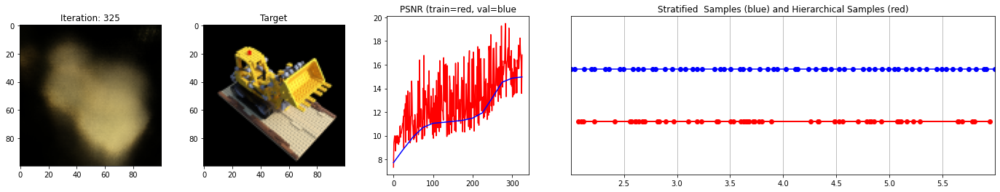

  4%|▎         | 350/10000 [01:56<55:09,  2.92it/s]

Loss: 0.028018495067954063


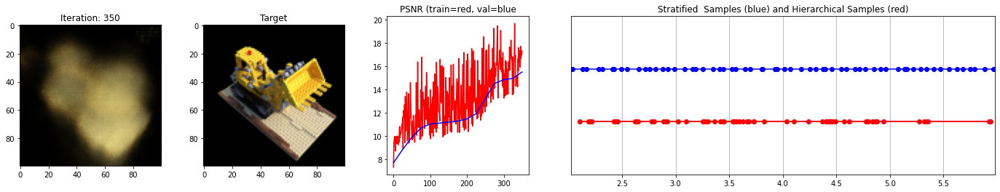

  4%|▍         | 375/10000 [02:05<55:02,  2.91it/s]

Loss: 0.025141455233097076


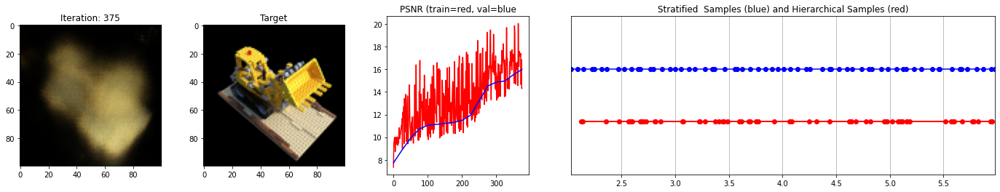

  4%|▍         | 400/10000 [02:14<55:13,  2.90it/s]

Loss: 0.0253190528601408


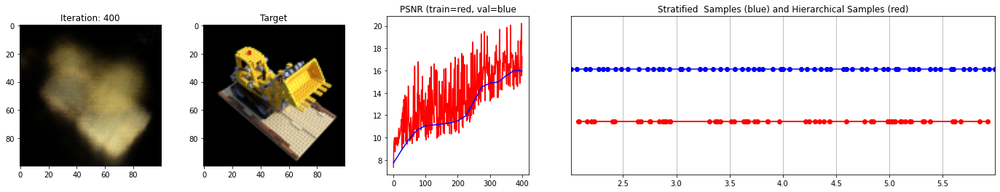

  4%|▍         | 425/10000 [02:23<55:03,  2.90it/s]

Loss: 0.02229626476764679


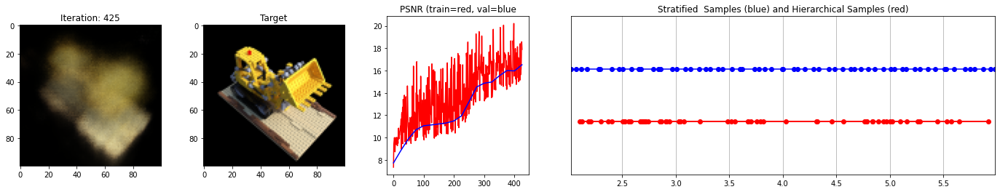

  4%|▍         | 450/10000 [02:33<54:48,  2.90it/s]

Loss: 0.0205281600356102


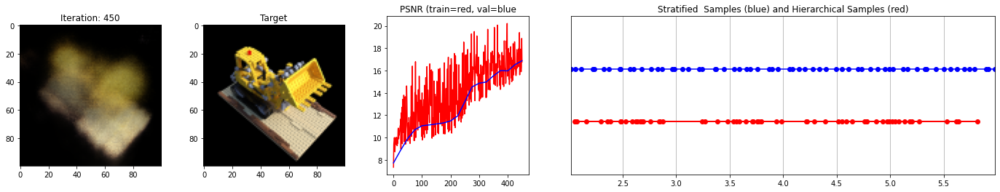

  5%|▍         | 475/10000 [02:42<54:33,  2.91it/s]

Loss: 0.018565678969025612


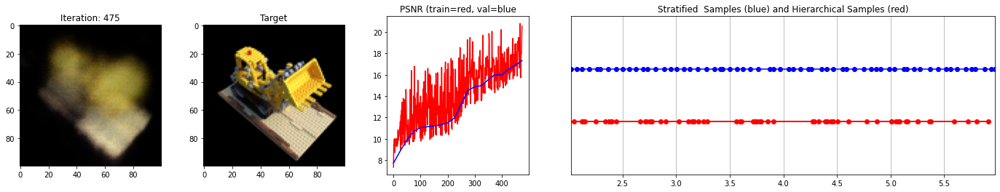

  5%|▌         | 500/10000 [02:51<54:13,  2.92it/s]

Loss: 0.01777133159339428


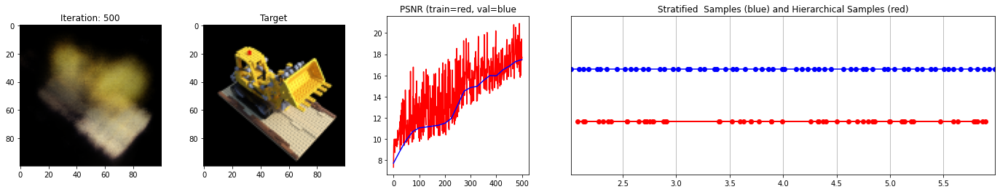

  5%|▌         | 525/10000 [03:00<54:32,  2.90it/s]

Loss: 0.019012076780200005


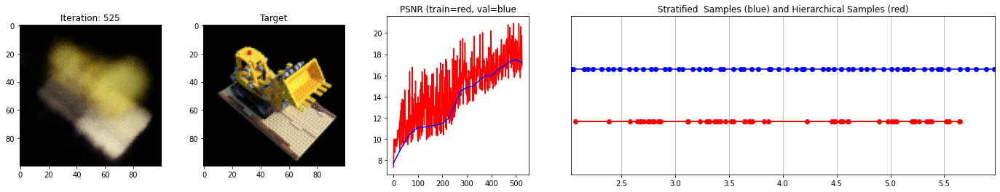

  6%|▌         | 550/10000 [03:10<54:10,  2.91it/s]

Loss: 0.01743331551551819


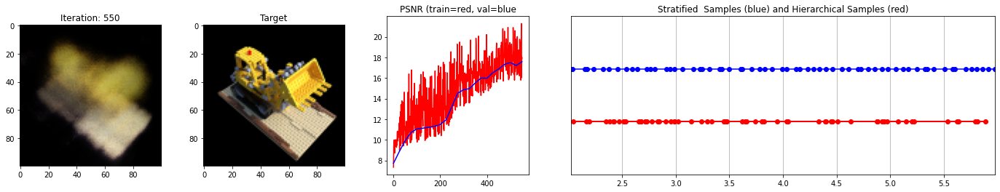

  6%|▌         | 575/10000 [03:19<54:08,  2.90it/s]

Loss: 0.016263995319604874


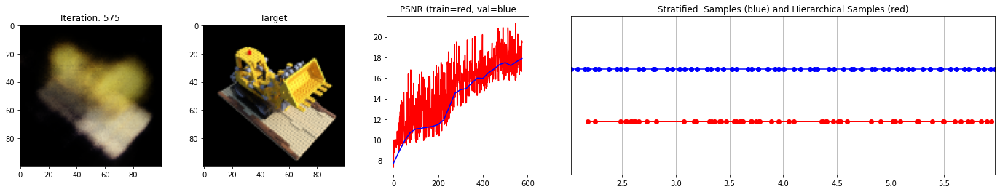

  6%|▌         | 600/10000 [03:28<54:03,  2.90it/s]

Loss: 0.01556322444230318


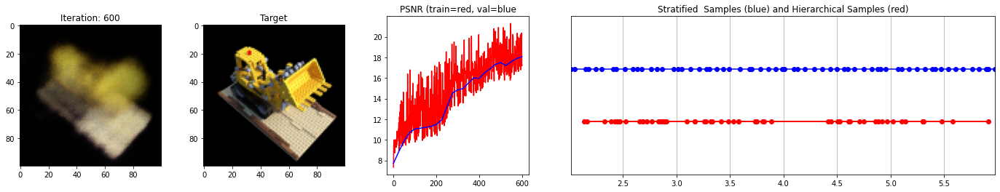

  6%|▋         | 625/10000 [03:37<53:49,  2.90it/s]

Loss: 0.016325723379850388


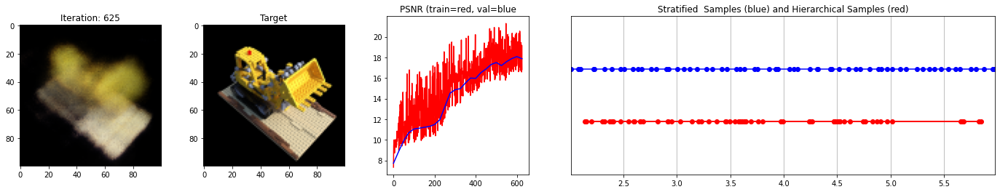

  6%|▋         | 650/10000 [03:47<53:54,  2.89it/s]

Loss: 0.016054026782512665


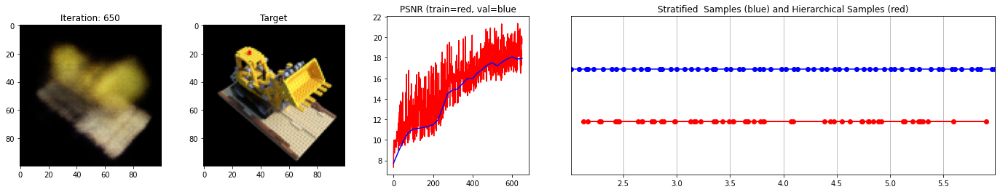

  7%|▋         | 675/10000 [03:56<53:29,  2.91it/s]

Loss: 0.016036370769143105


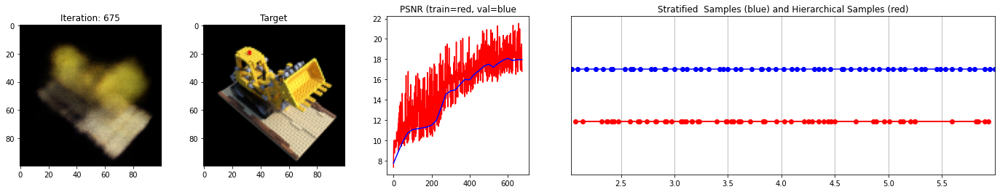

  7%|▋         | 700/10000 [04:05<53:29,  2.90it/s]

Loss: 0.013962206430733204


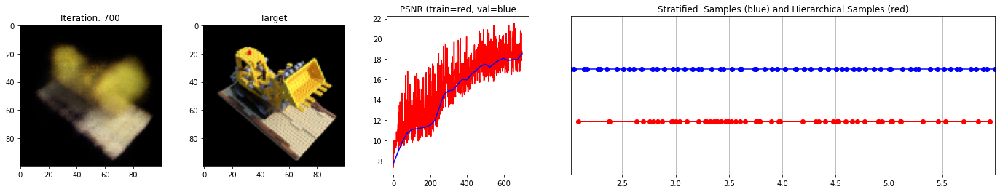

  7%|▋         | 725/10000 [04:14<53:14,  2.90it/s]

Loss: 0.01477088499814272


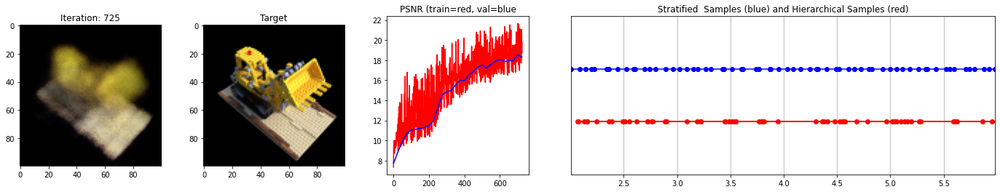

  8%|▊         | 750/10000 [04:24<53:05,  2.90it/s]

Loss: 0.014185560867190361


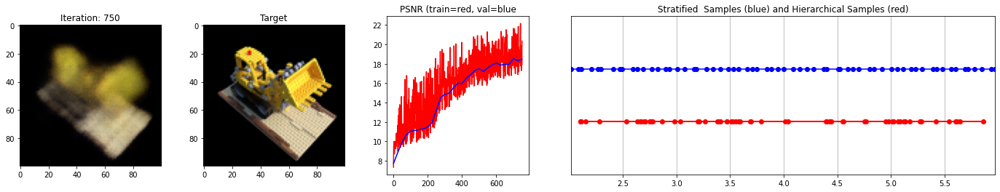

  8%|▊         | 775/10000 [04:33<52:58,  2.90it/s]

Loss: 0.013999542221426964


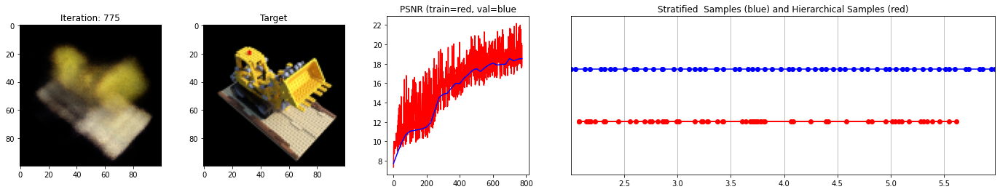

  8%|▊         | 800/10000 [04:42<52:46,  2.91it/s]

Loss: 0.012602036818861961


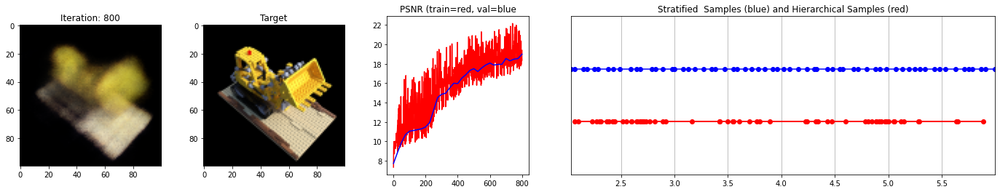

  8%|▊         | 825/10000 [04:52<52:39,  2.90it/s]

Loss: 0.012482788413763046


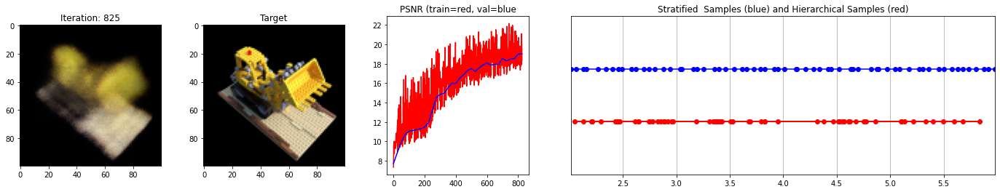

  8%|▊         | 850/10000 [05:01<52:47,  2.89it/s]

Loss: 0.012213926762342453


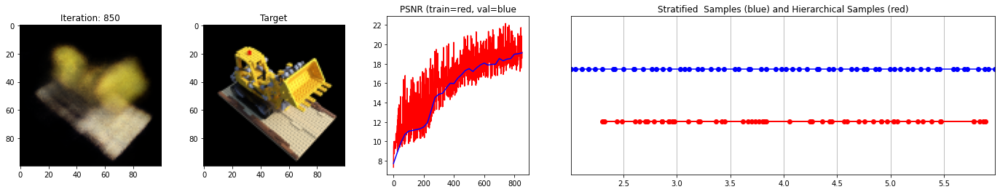

  9%|▉         | 875/10000 [05:10<52:20,  2.91it/s]

Loss: 0.012808145955204964


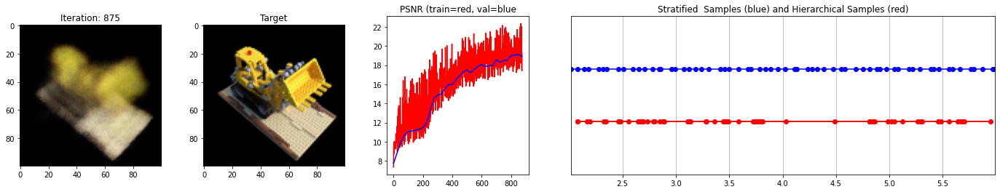

  9%|▉         | 900/10000 [05:20<52:14,  2.90it/s]

Loss: 0.012834091670811176


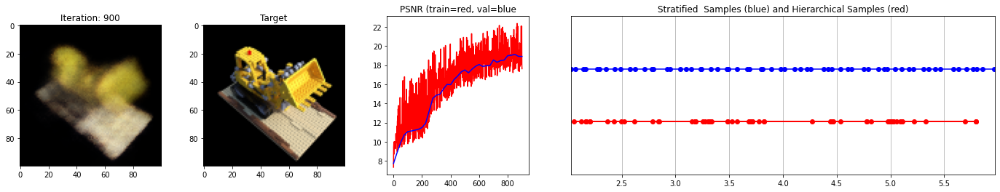

  9%|▉         | 925/10000 [05:29<52:17,  2.89it/s]

Loss: 0.011823901906609535


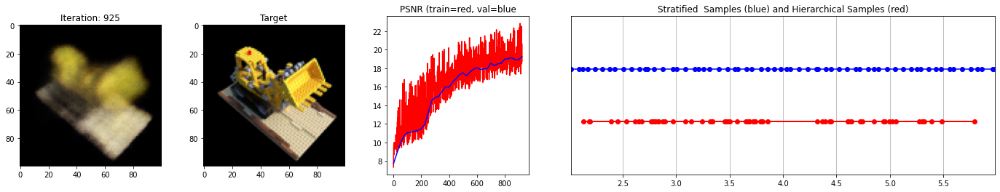

 10%|▉         | 950/10000 [05:38<52:15,  2.89it/s]

Loss: 0.01269647479057312


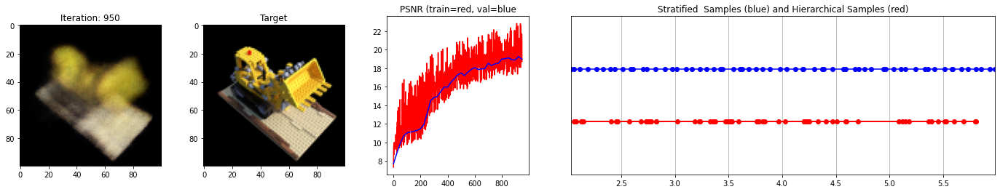

 10%|▉         | 975/10000 [05:48<52:03,  2.89it/s]

Loss: 0.012672407552599907


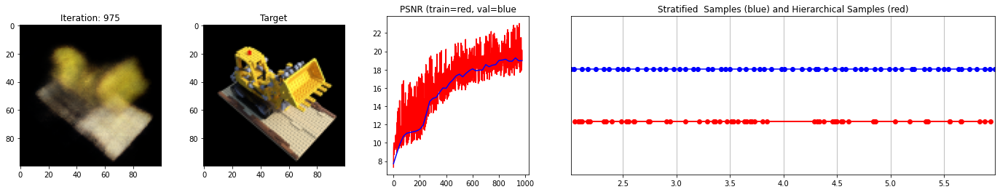

 10%|█         | 1000/10000 [05:57<52:08,  2.88it/s]

Loss: 0.01143154688179493


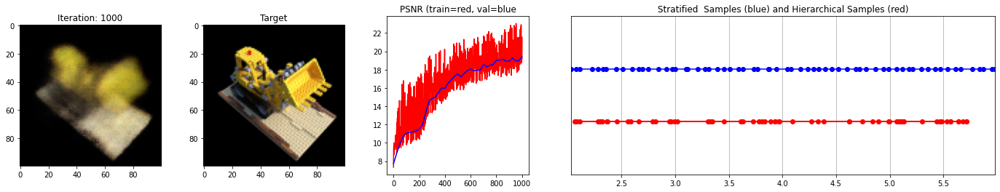

 10%|█         | 1025/10000 [06:06<51:55,  2.88it/s]

Loss: 0.01209940854460001


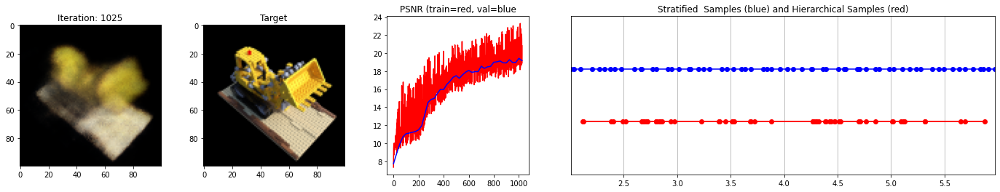

 10%|█         | 1050/10000 [06:16<51:33,  2.89it/s]

Loss: 0.01263920683413744


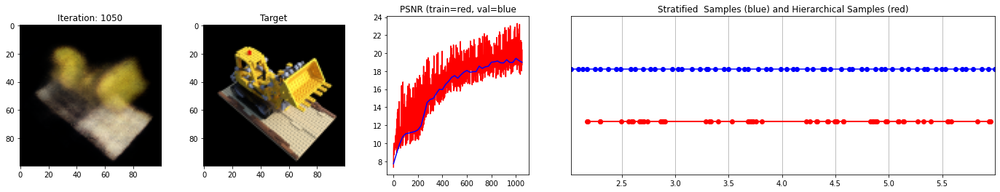

 11%|█         | 1075/10000 [06:25<51:23,  2.89it/s]

Loss: 0.011243563145399094


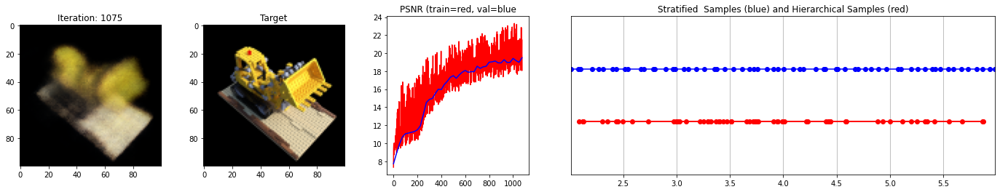

 11%|█         | 1100/10000 [06:34<51:12,  2.90it/s]

Loss: 0.012430666014552116


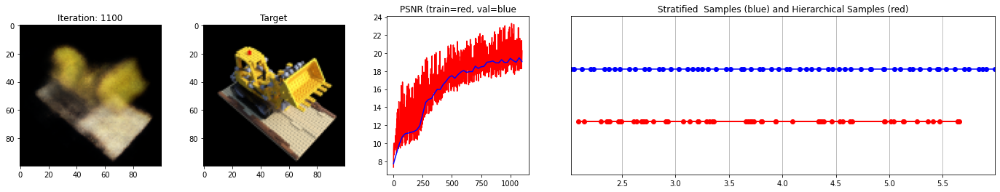

 11%|█▏        | 1125/10000 [06:43<51:07,  2.89it/s]

Loss: 0.01132448110729456


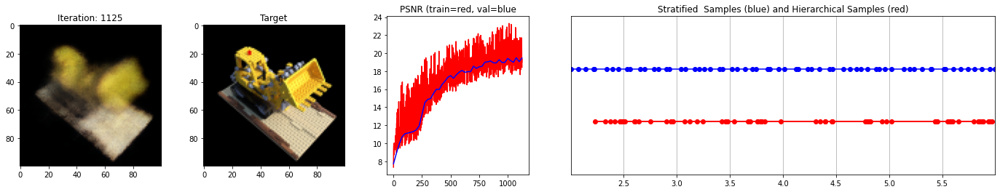

 12%|█▏        | 1150/10000 [06:53<51:02,  2.89it/s]

Loss: 0.010874147526919842


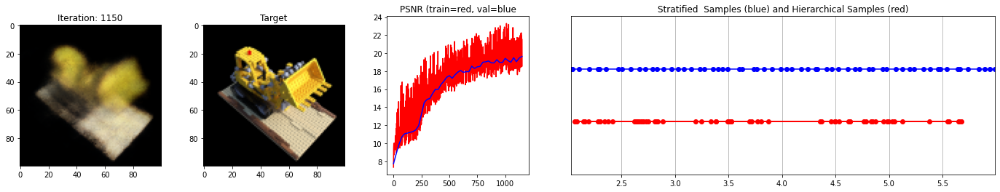

 12%|█▏        | 1175/10000 [07:02<50:50,  2.89it/s]

Loss: 0.011676116846501827


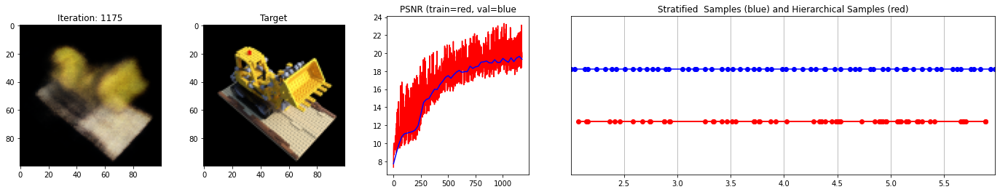

 12%|█▏        | 1200/10000 [07:12<50:39,  2.90it/s]

Loss: 0.011946232058107853


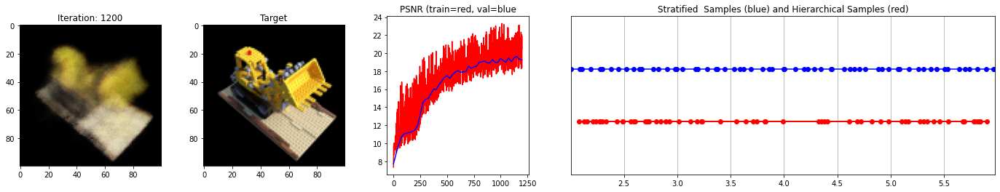

 12%|█▏        | 1225/10000 [07:21<50:26,  2.90it/s]

Loss: 0.010529138147830963


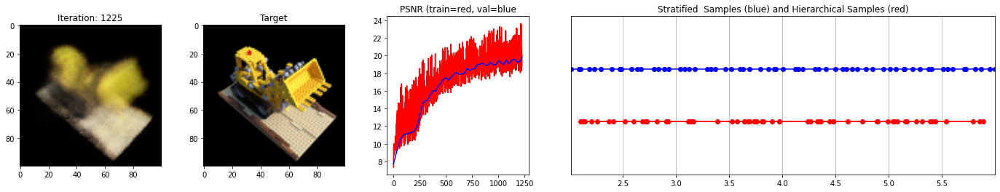

 12%|█▎        | 1250/10000 [07:30<50:21,  2.90it/s]

Loss: 0.010384554974734783


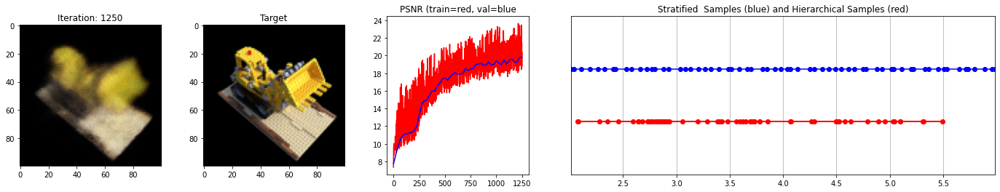

 13%|█▎        | 1275/10000 [07:40<50:23,  2.89it/s]

Loss: 0.010206113569438457


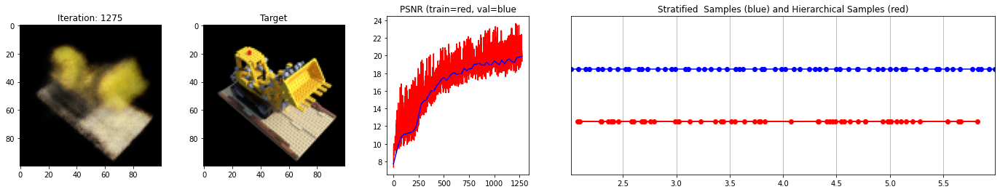

 13%|█▎        | 1300/10000 [07:49<50:07,  2.89it/s]

Loss: 0.01081572100520134


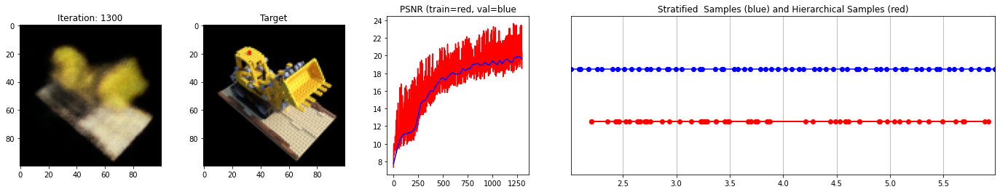

 13%|█▎        | 1325/10000 [07:58<49:50,  2.90it/s]

Loss: 0.010969671420753002


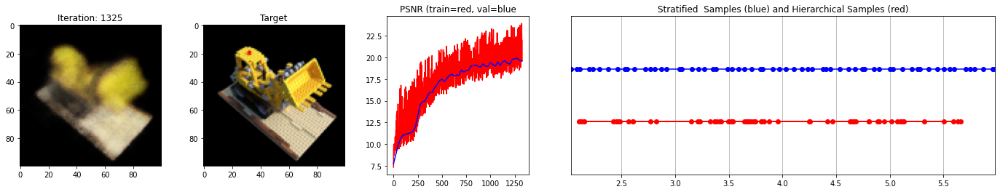

 14%|█▎        | 1350/10000 [08:08<49:56,  2.89it/s]

Loss: 0.009835288859903812


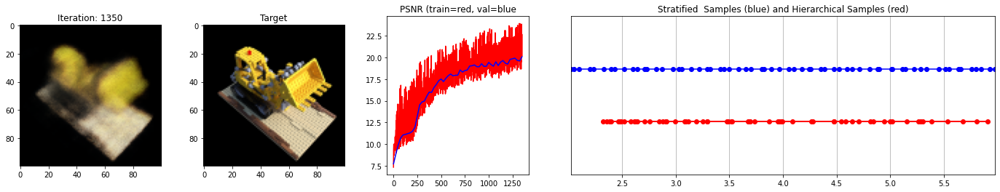

 14%|█▍        | 1375/10000 [08:17<49:46,  2.89it/s]

Loss: 0.010224180296063423


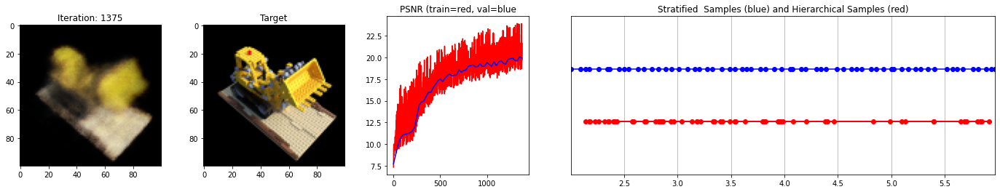

 14%|█▍        | 1400/10000 [08:26<49:28,  2.90it/s]

Loss: 0.009834248572587967


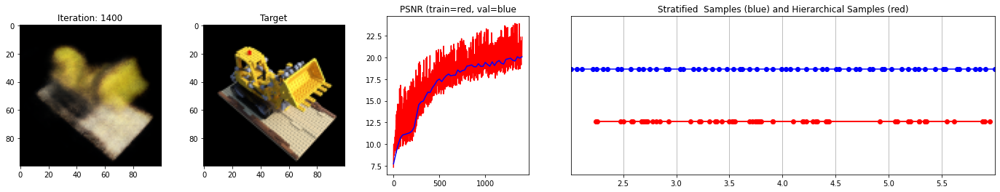

 14%|█▍        | 1425/10000 [08:36<49:26,  2.89it/s]

Loss: 0.00967042613774538


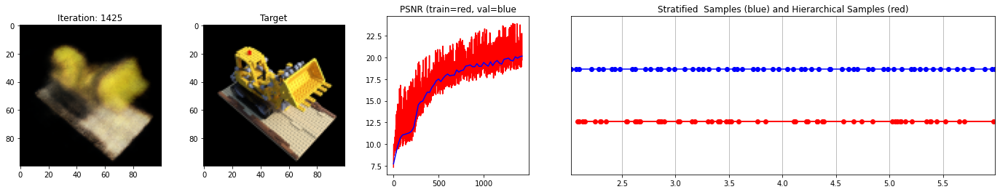

 14%|█▍        | 1450/10000 [08:45<49:14,  2.89it/s]

Loss: 0.009763209149241447


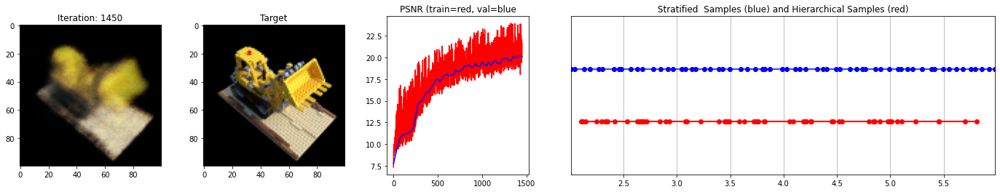

 15%|█▍        | 1475/10000 [08:54<49:07,  2.89it/s]

Loss: 0.010607033967971802


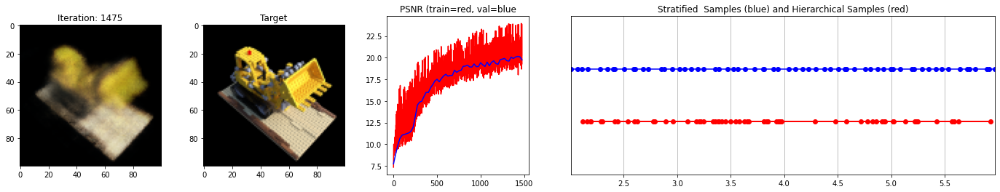

 15%|█▌        | 1500/10000 [09:04<49:00,  2.89it/s]

Loss: 0.009812855161726475


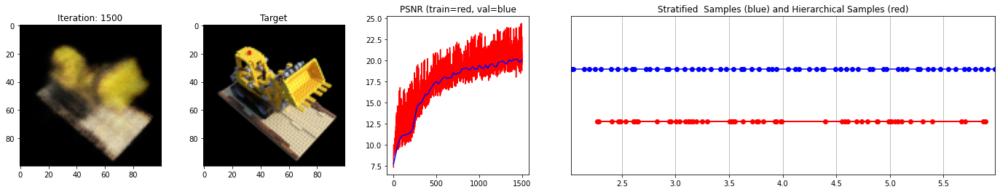

 15%|█▌        | 1525/10000 [09:13<48:50,  2.89it/s]

Loss: 0.011194456368684769


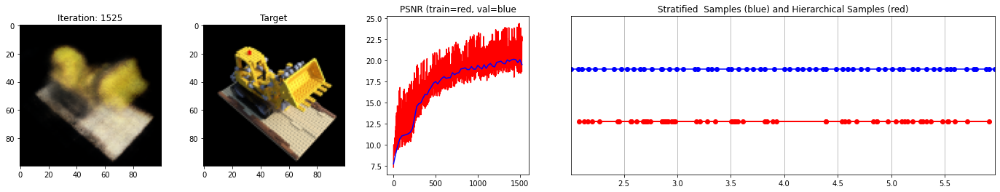

 16%|█▌        | 1550/10000 [09:22<48:50,  2.88it/s]

Loss: 0.010114560835063457


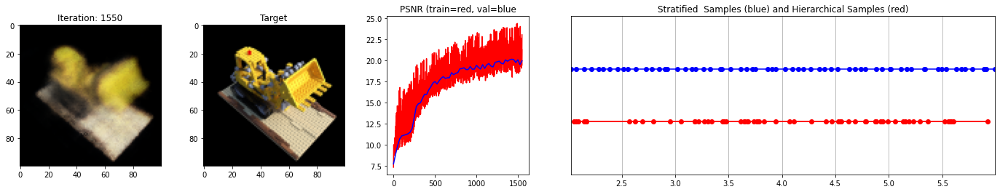

 16%|█▌        | 1575/10000 [09:32<48:35,  2.89it/s]

Loss: 0.009994618594646454


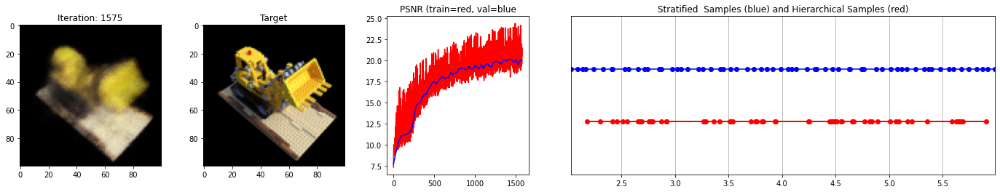

 16%|█▌        | 1600/10000 [09:41<48:18,  2.90it/s]

Loss: 0.009466072544455528


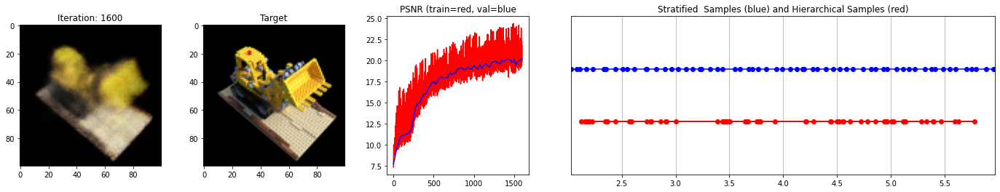

 16%|█▋        | 1625/10000 [09:50<48:22,  2.89it/s]

Loss: 0.00926911924034357


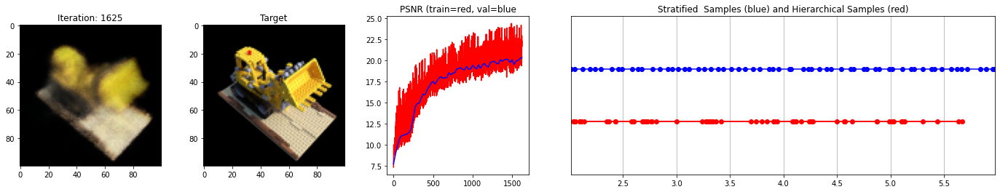

 16%|█▋        | 1650/10000 [10:00<48:18,  2.88it/s]

Loss: 0.009423110634088516


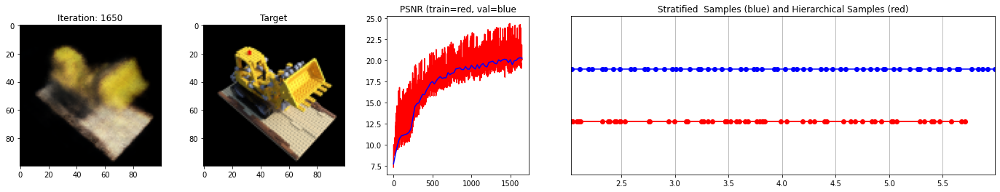

 17%|█▋        | 1675/10000 [10:09<48:04,  2.89it/s]

Loss: 0.009291020222008228


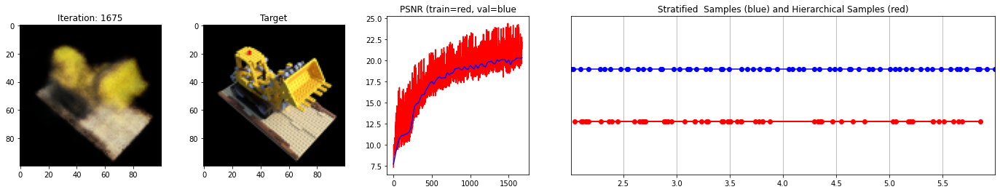

 17%|█▋        | 1700/10000 [10:18<47:47,  2.89it/s]

Loss: 0.010061885230243206


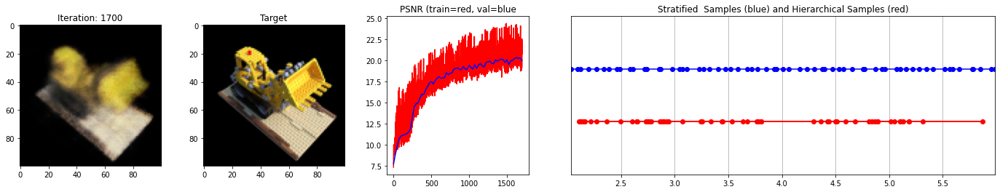

 17%|█▋        | 1725/10000 [10:28<47:36,  2.90it/s]

Loss: 0.009169218130409718


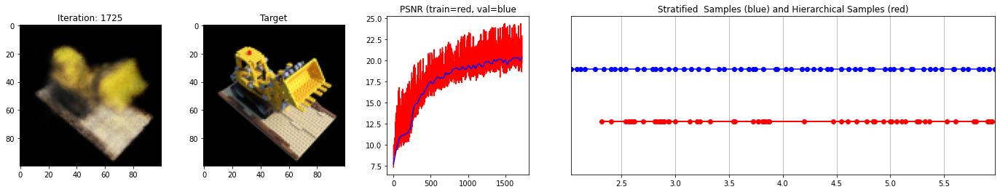

 18%|█▊        | 1750/10000 [10:37<47:40,  2.88it/s]

Loss: 0.009774584323167801


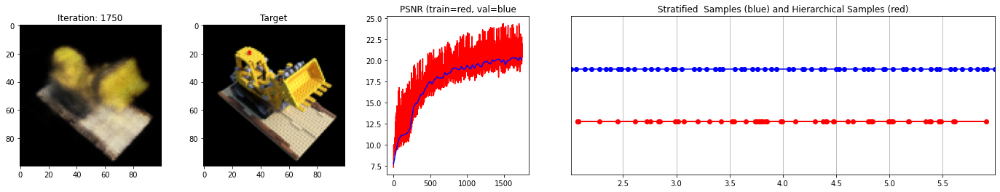

 18%|█▊        | 1775/10000 [10:46<47:21,  2.89it/s]

Loss: 0.00939883477985859


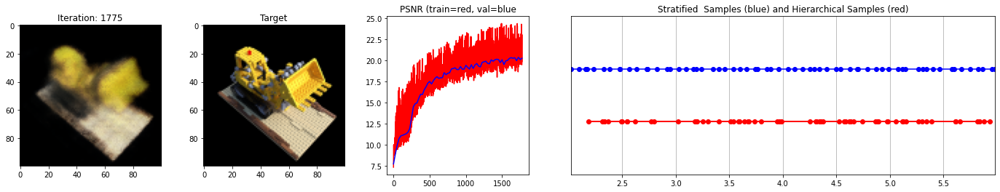

 18%|█▊        | 1800/10000 [10:56<47:32,  2.87it/s]

Loss: 0.00966847874224186


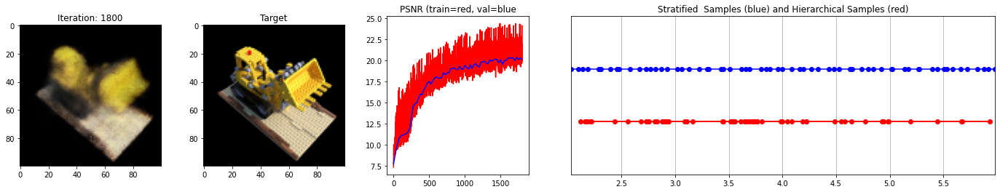

 18%|█▊        | 1825/10000 [11:05<47:07,  2.89it/s]

Loss: 0.009128810837864876


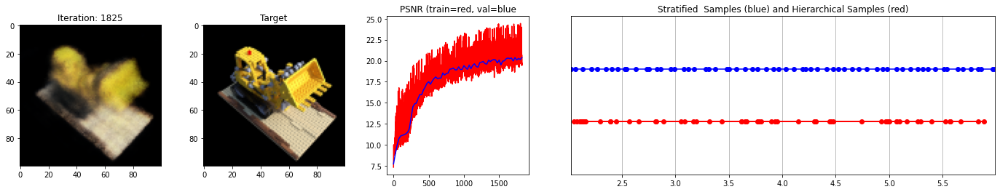

 18%|█▊        | 1850/10000 [11:14<47:04,  2.89it/s]

Loss: 0.009648166596889496


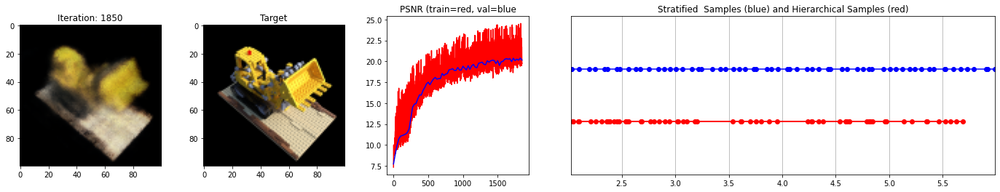

 19%|█▉        | 1875/10000 [11:24<46:59,  2.88it/s]

Loss: 0.009120662696659565


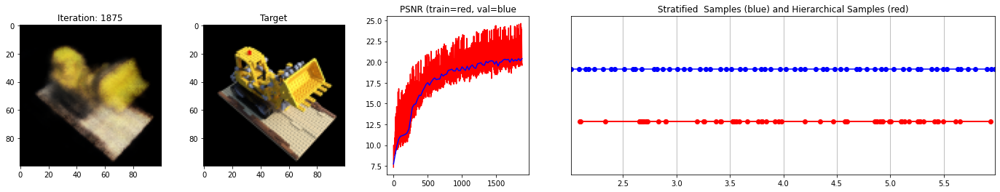

 19%|█▉        | 1900/10000 [11:33<46:43,  2.89it/s]

Loss: 0.009067929349839687


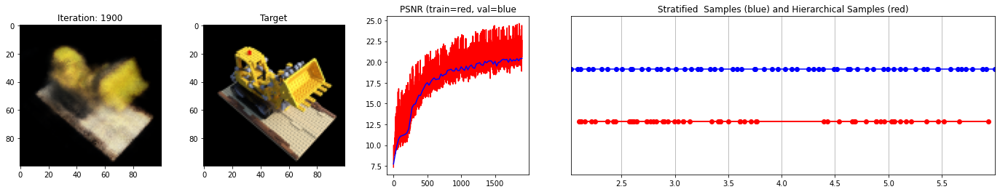

 19%|█▉        | 1925/10000 [11:42<46:35,  2.89it/s]

Loss: 0.008990061469376087


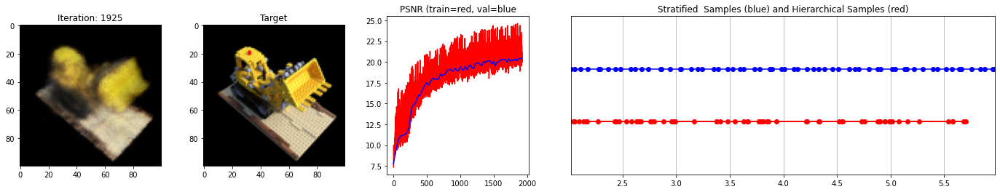

 20%|█▉        | 1950/10000 [11:52<46:30,  2.88it/s]

Loss: 0.009364300407469273


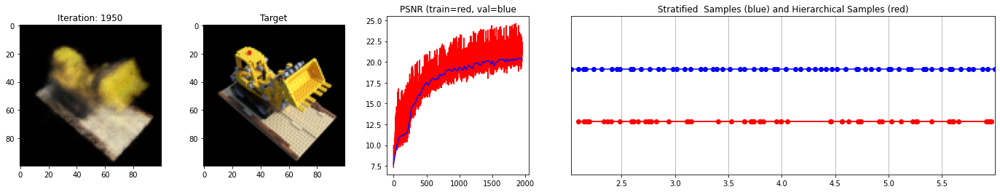

 20%|█▉        | 1975/10000 [12:01<46:18,  2.89it/s]

Loss: 0.00925387442111969


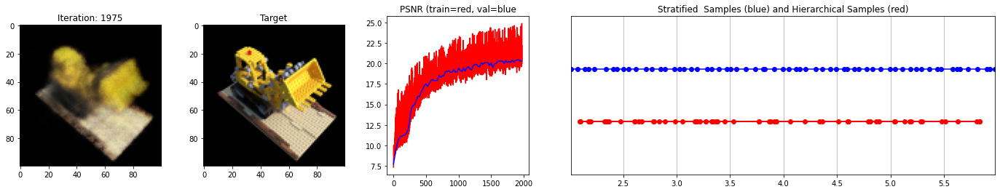

 20%|██        | 2000/10000 [12:11<46:09,  2.89it/s]

Loss: 0.008898340165615082


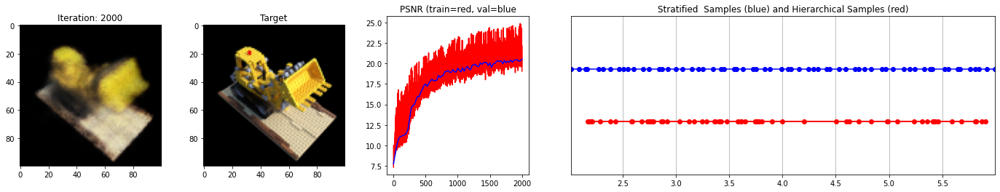

 20%|██        | 2025/10000 [12:20<46:01,  2.89it/s]

Loss: 0.008687976747751236


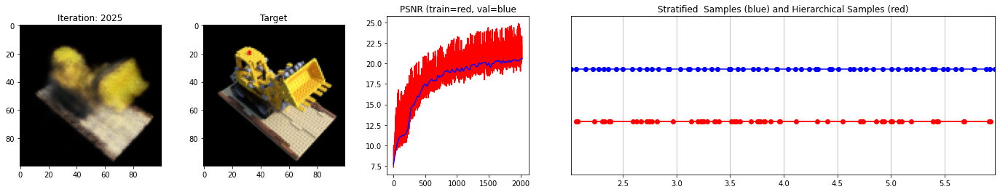

 20%|██        | 2050/10000 [12:29<45:40,  2.90it/s]

Loss: 0.009042317047715187


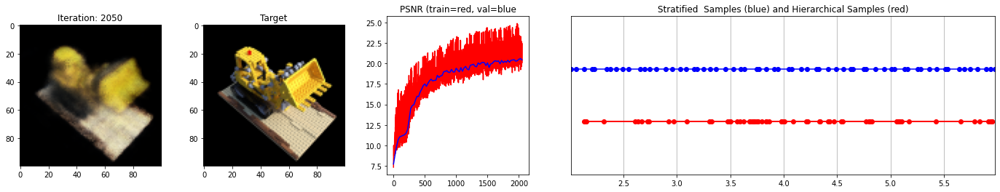

 21%|██        | 2075/10000 [12:39<45:36,  2.90it/s]

Loss: 0.00866752490401268


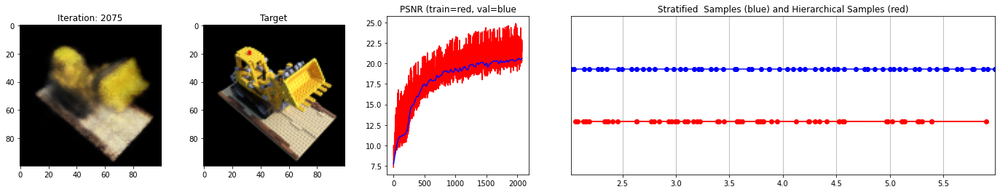

 21%|██        | 2100/10000 [12:48<45:34,  2.89it/s]

Loss: 0.009358310140669346


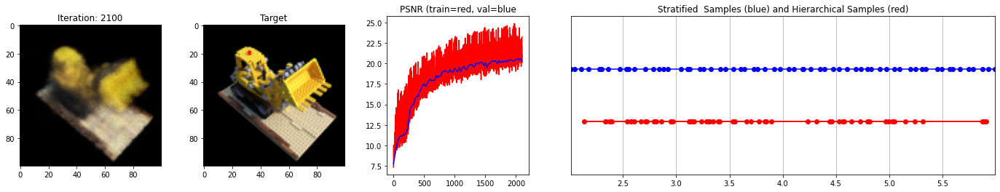

 21%|██▏       | 2125/10000 [12:57<45:31,  2.88it/s]

Loss: 0.009414125233888626


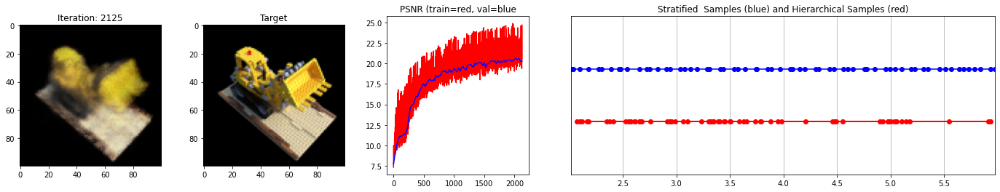

 22%|██▏       | 2150/10000 [13:07<45:14,  2.89it/s]

Loss: 0.008898444473743439


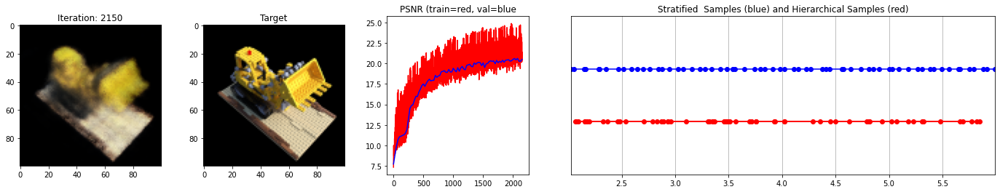

 22%|██▏       | 2175/10000 [13:16<45:08,  2.89it/s]

Loss: 0.008625390939414501


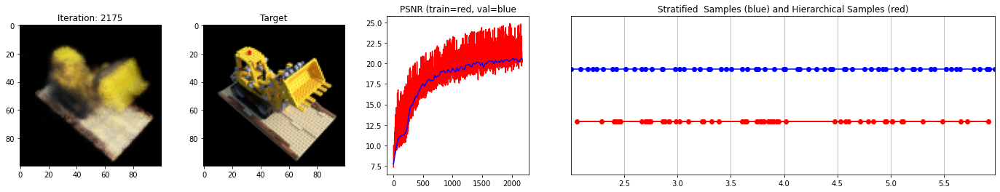

 22%|██▏       | 2200/10000 [13:25<45:05,  2.88it/s]

Loss: 0.00854858011007309


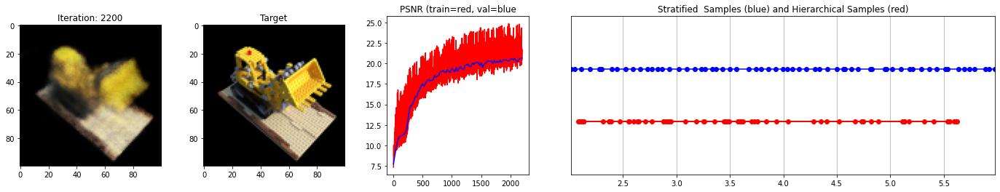

 22%|██▏       | 2225/10000 [13:35<44:45,  2.90it/s]

Loss: 0.008345440961420536


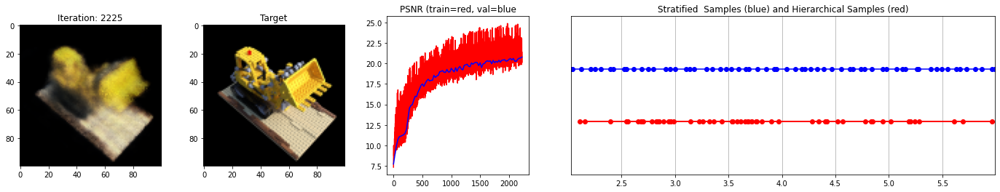

 22%|██▎       | 2250/10000 [13:44<44:35,  2.90it/s]

Loss: 0.009104494005441666


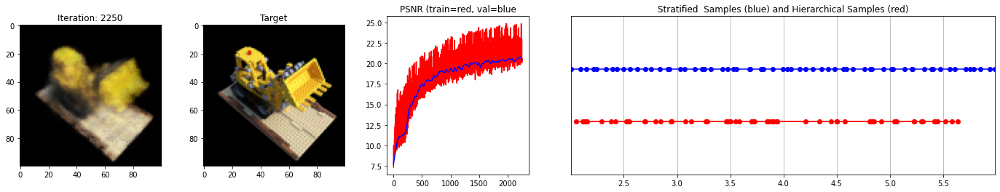

 23%|██▎       | 2275/10000 [13:53<44:47,  2.87it/s]

Loss: 0.008324784226715565


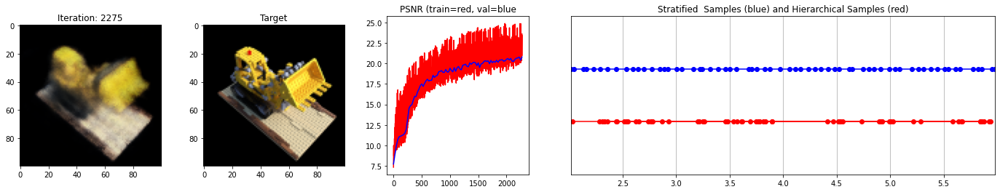

 23%|██▎       | 2300/10000 [14:03<44:29,  2.88it/s]

Loss: 0.00838602613657713


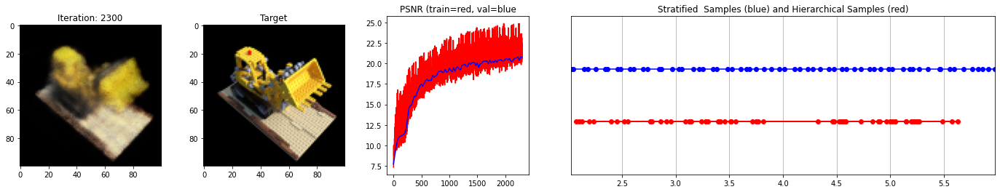

 23%|██▎       | 2325/10000 [14:12<44:02,  2.90it/s]

Loss: 0.008332020603120327


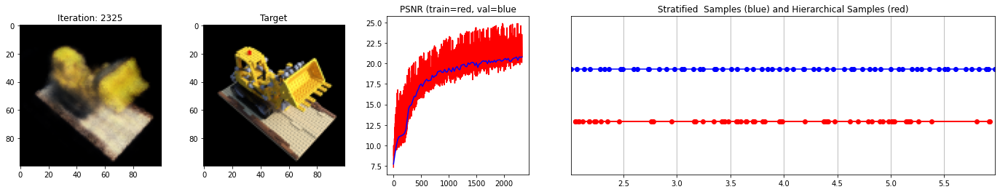

 24%|██▎       | 2350/10000 [14:21<44:00,  2.90it/s]

Loss: 0.008619804866611958


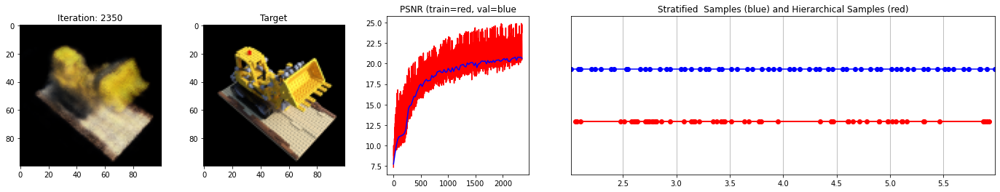

 24%|██▍       | 2375/10000 [14:31<44:01,  2.89it/s]

Loss: 0.0080214012414217


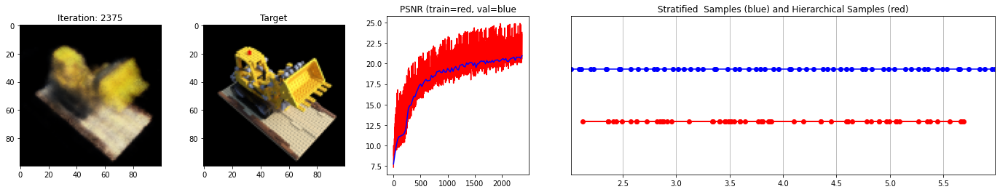

 24%|██▍       | 2400/10000 [14:40<44:02,  2.88it/s]

Loss: 0.007965504191815853


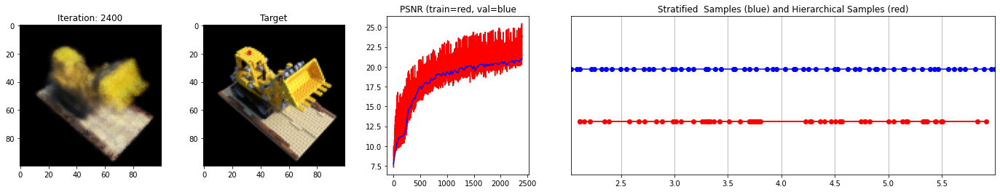

 24%|██▍       | 2425/10000 [14:50<43:42,  2.89it/s]

Loss: 0.009540177881717682


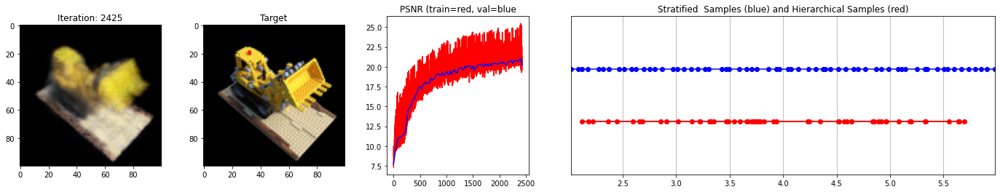

 24%|██▍       | 2450/10000 [14:59<43:26,  2.90it/s]

Loss: 0.008410988375544548


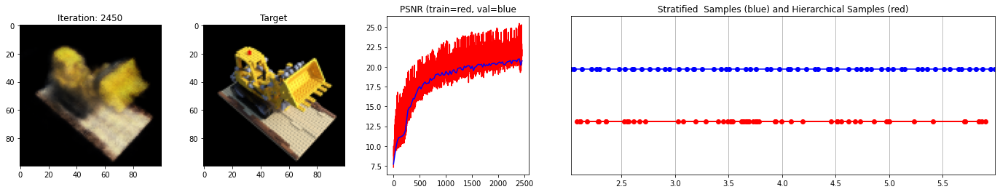

 25%|██▍       | 2475/10000 [15:08<43:21,  2.89it/s]

Loss: 0.008403548039495945


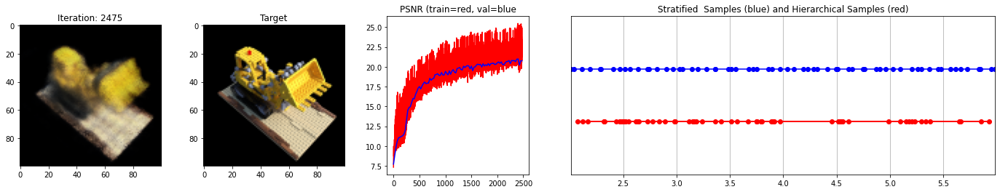

 25%|██▌       | 2500/10000 [15:18<43:05,  2.90it/s]

Loss: 0.00793280266225338


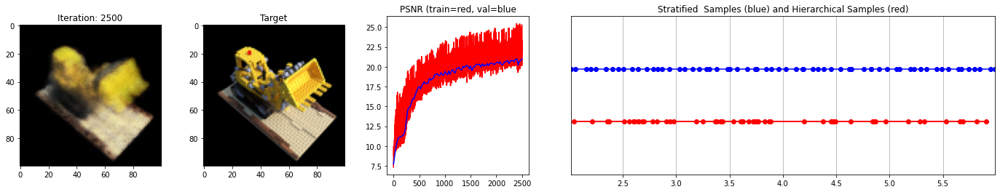

 25%|██▌       | 2525/10000 [15:27<43:08,  2.89it/s]

Loss: 0.007830196060240269


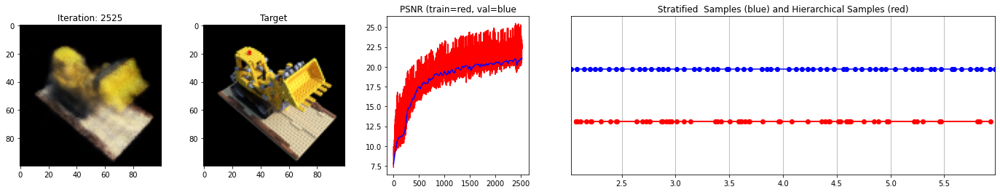

 26%|██▌       | 2550/10000 [15:36<42:51,  2.90it/s]

Loss: 0.008244306780397892


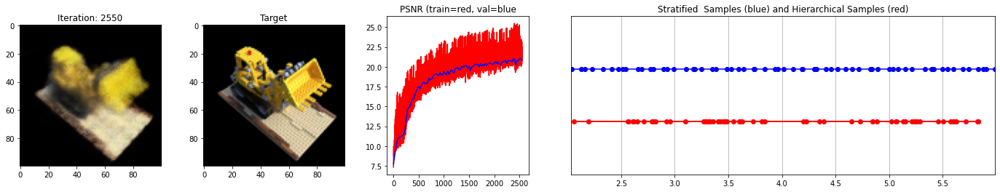

 26%|██▌       | 2575/10000 [15:46<42:50,  2.89it/s]

Loss: 0.007825121283531189


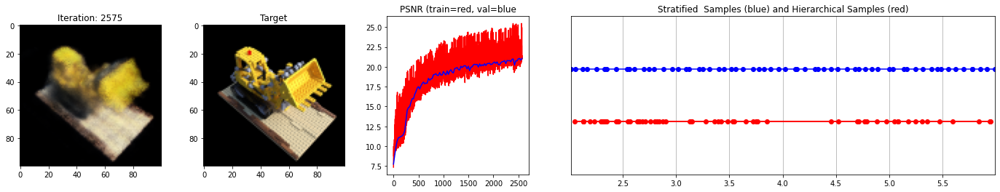

 26%|██▌       | 2600/10000 [15:55<42:35,  2.90it/s]

Loss: 0.007748666685074568


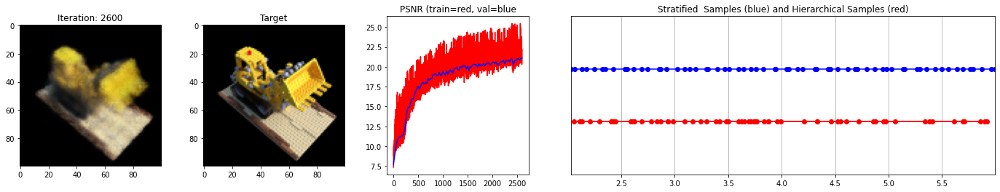

 26%|██▋       | 2625/10000 [16:04<42:38,  2.88it/s]

Loss: 0.007696853950619698


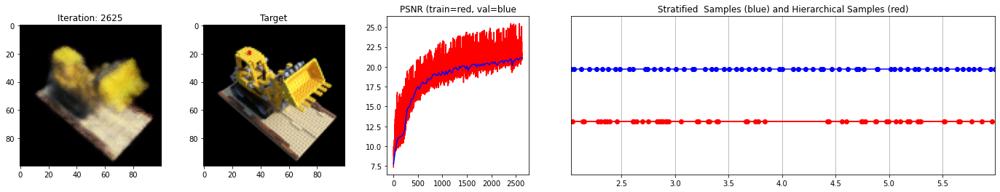

 26%|██▋       | 2650/10000 [16:14<42:26,  2.89it/s]

Loss: 0.007762294728308916


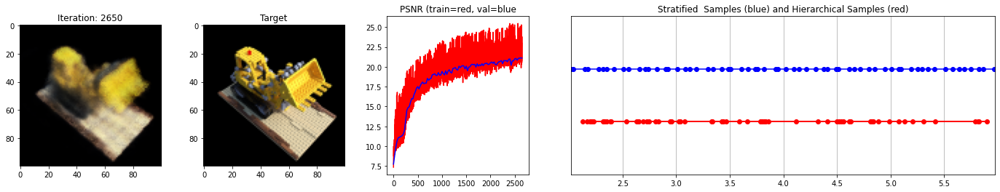

 27%|██▋       | 2675/10000 [16:23<42:14,  2.89it/s]

Loss: 0.00835216511040926


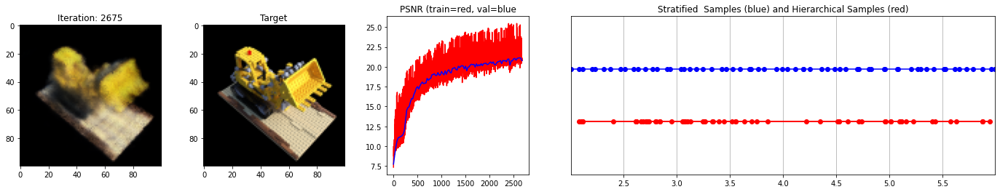

 27%|██▋       | 2700/10000 [16:32<42:09,  2.89it/s]

Loss: 0.007460316643118858


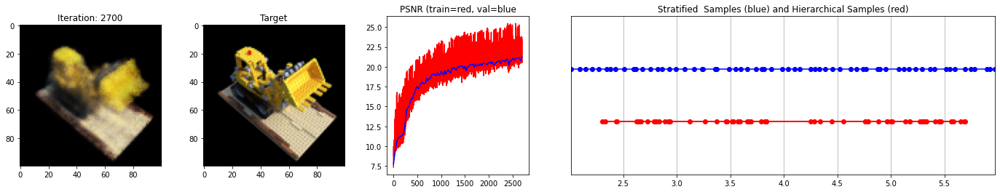

 27%|██▋       | 2725/10000 [16:43<41:52,  2.90it/s]

Loss: 0.007710163481533527


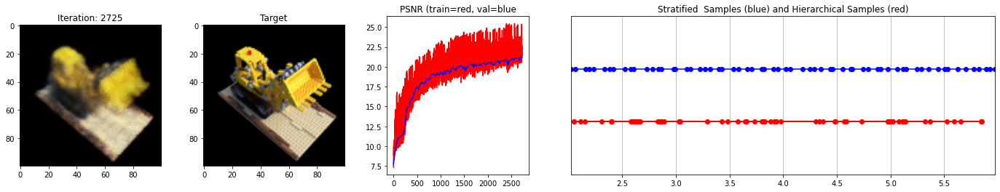

 28%|██▊       | 2750/10000 [16:53<41:51,  2.89it/s]

Loss: 0.008049155585467815


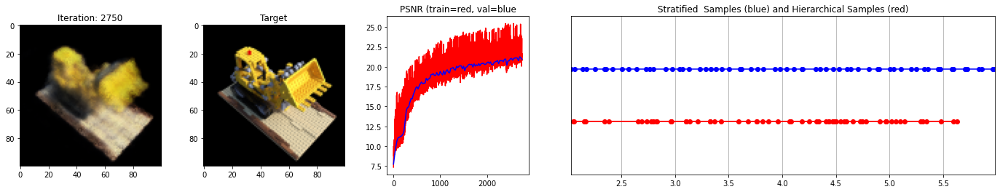

 28%|██▊       | 2775/10000 [17:02<41:35,  2.89it/s]

Loss: 0.007490625139325857


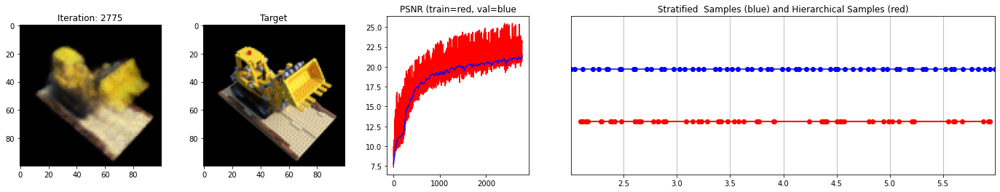

 28%|██▊       | 2800/10000 [17:11<41:20,  2.90it/s]

Loss: 0.0074986908584833145


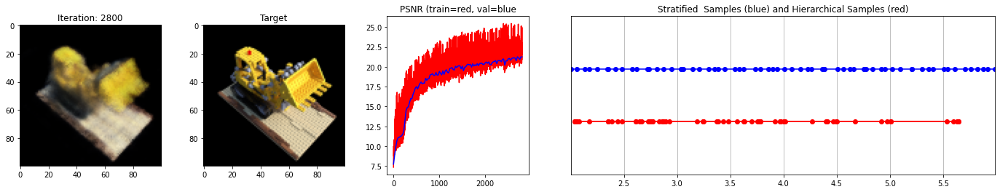

 28%|██▊       | 2825/10000 [17:21<41:25,  2.89it/s]

Loss: 0.007435963023453951


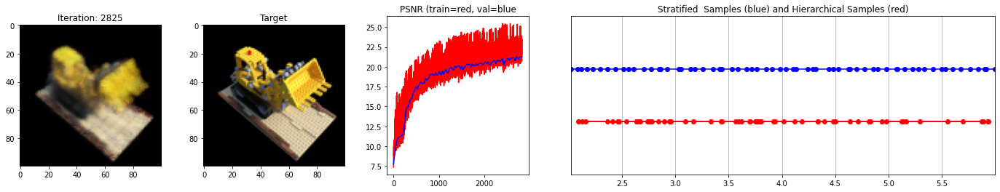

 28%|██▊       | 2850/10000 [17:30<41:08,  2.90it/s]

Loss: 0.007420273032039404


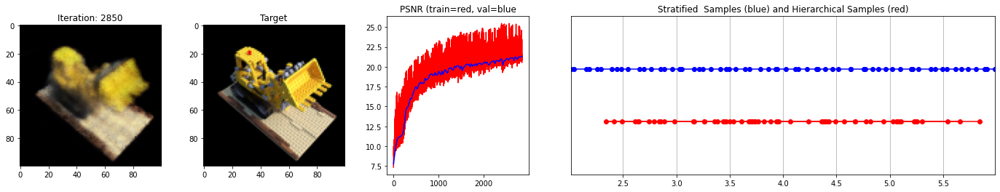

 29%|██▉       | 2875/10000 [17:39<40:54,  2.90it/s]

Loss: 0.007325650192797184


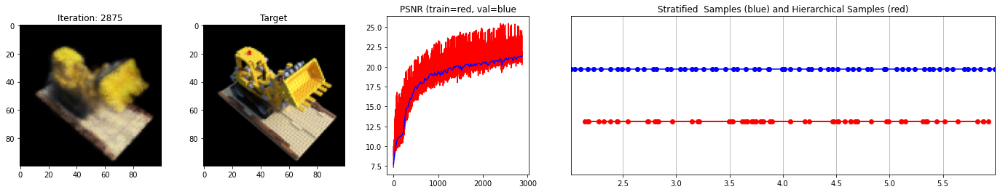

 29%|██▉       | 2900/10000 [17:49<40:45,  2.90it/s]

Loss: 0.007250044960528612


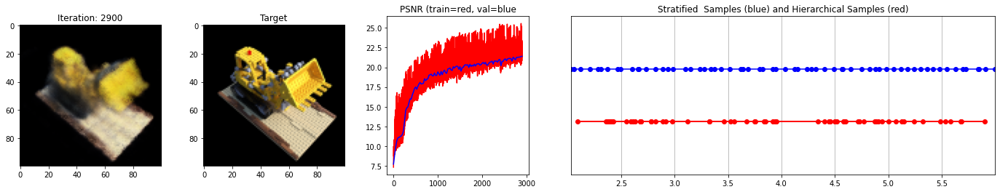

 29%|██▉       | 2925/10000 [17:58<40:43,  2.90it/s]

Loss: 0.007194433826953173


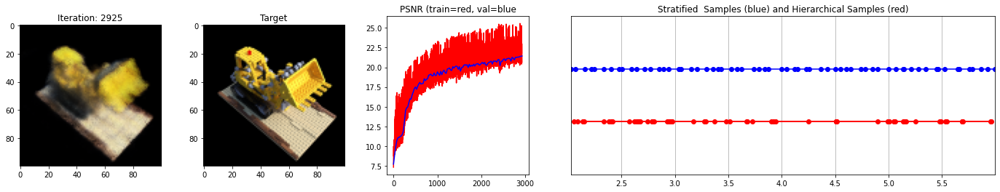

 30%|██▉       | 2950/10000 [18:07<40:36,  2.89it/s]

Loss: 0.007595834322273731


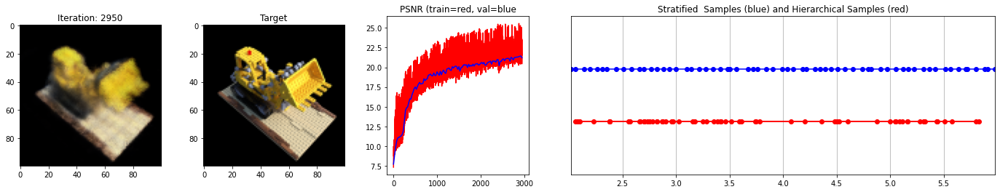

 30%|██▉       | 2975/10000 [18:17<40:35,  2.88it/s]

Loss: 0.00735265389084816


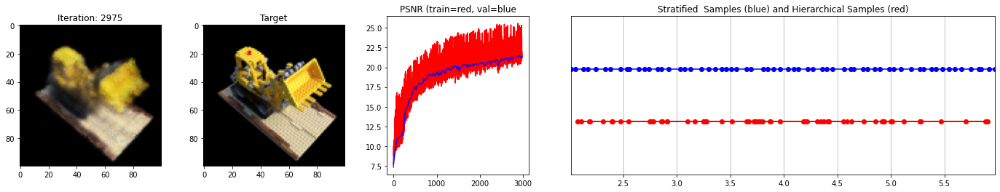

 30%|███       | 3000/10000 [18:26<40:38,  2.87it/s]

Loss: 0.007541086990386248


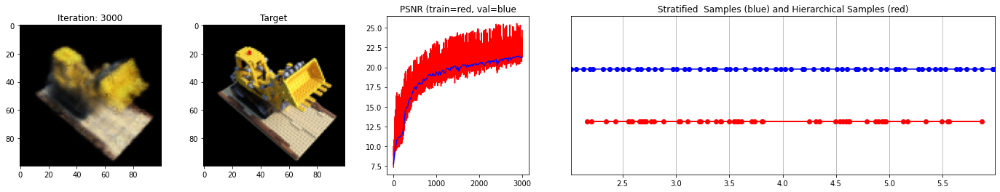

 30%|███       | 3025/10000 [18:36<40:10,  2.89it/s]

Loss: 0.007474073208868504


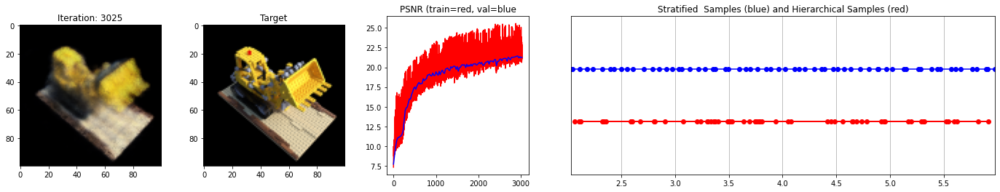

 30%|███       | 3050/10000 [18:45<39:59,  2.90it/s]

Loss: 0.007238603662699461


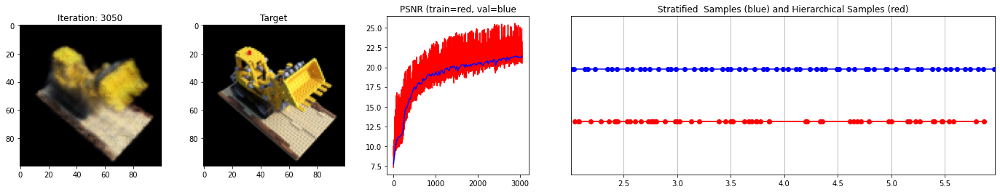

 31%|███       | 3075/10000 [18:54<39:58,  2.89it/s]

Loss: 0.00696253078058362


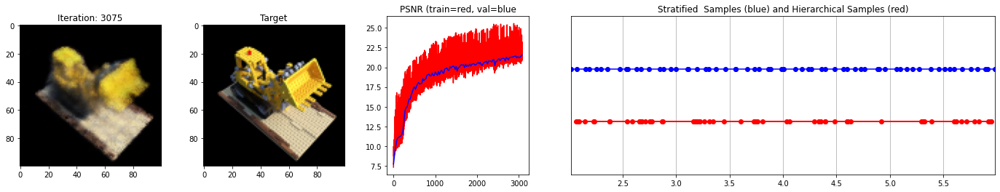

 31%|███       | 3100/10000 [19:04<39:39,  2.90it/s]

Loss: 0.007564413361251354


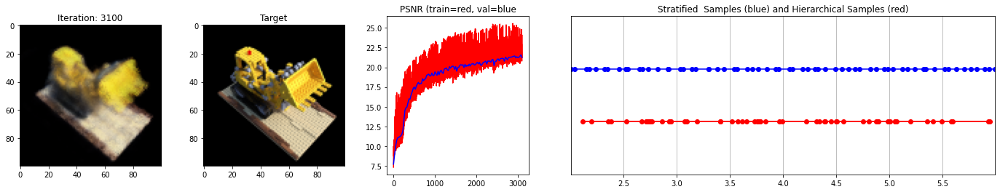

 31%|███▏      | 3125/10000 [19:13<39:35,  2.89it/s]

Loss: 0.006918970961123705


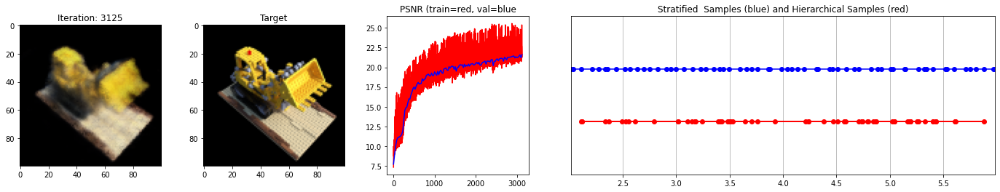

 32%|███▏      | 3150/10000 [19:22<39:31,  2.89it/s]

Loss: 0.00689655588939786


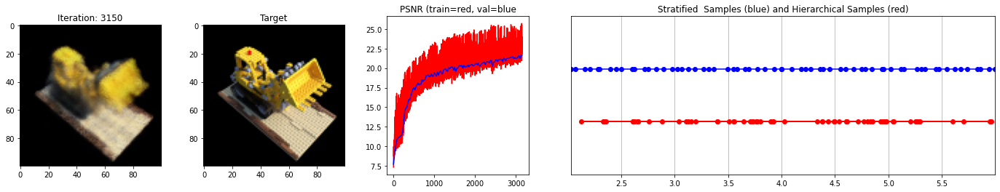

 32%|███▏      | 3175/10000 [19:32<39:19,  2.89it/s]

Loss: 0.006753763183951378


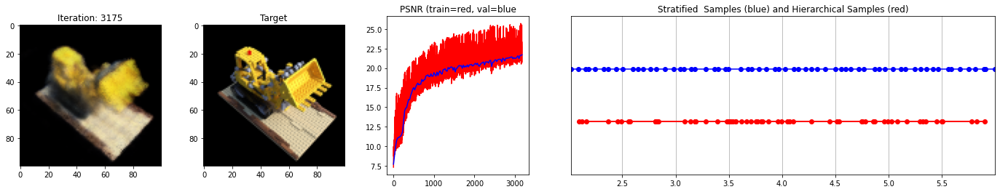

 32%|███▏      | 3200/10000 [19:41<39:12,  2.89it/s]

Loss: 0.006992776412516832


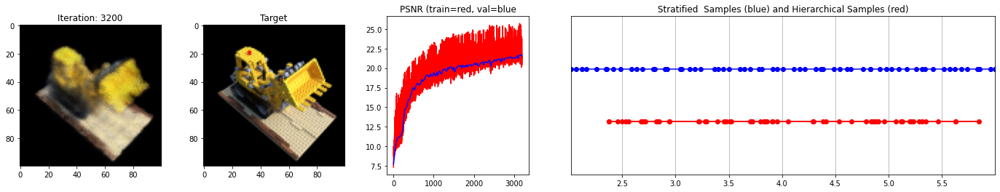

 32%|███▏      | 3225/10000 [19:51<38:57,  2.90it/s]

Loss: 0.006988948676735163


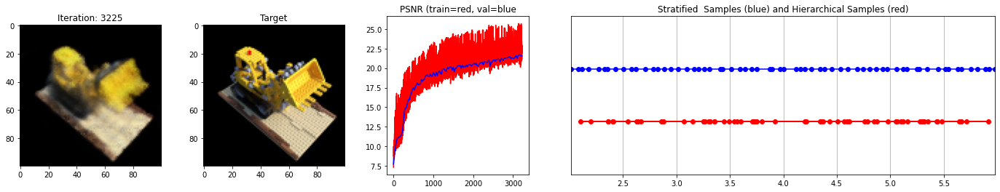

 32%|███▎      | 3250/10000 [20:00<38:41,  2.91it/s]

Loss: 0.006887514144182205


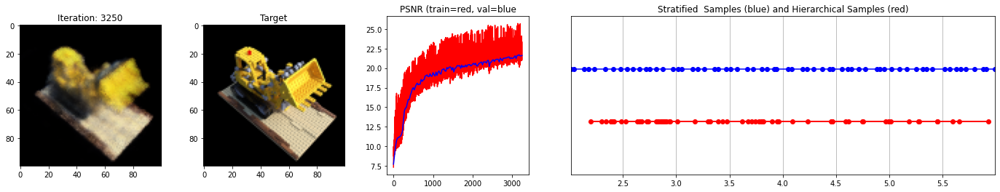

 33%|███▎      | 3275/10000 [20:09<40:13,  2.79it/s]

Loss: 0.007195719983428717


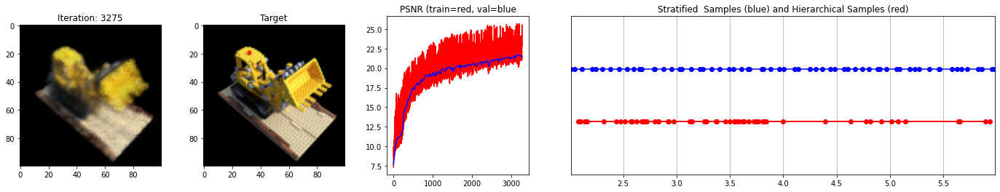

 33%|███▎      | 3300/10000 [20:19<38:33,  2.90it/s]

Loss: 0.007168952375650406


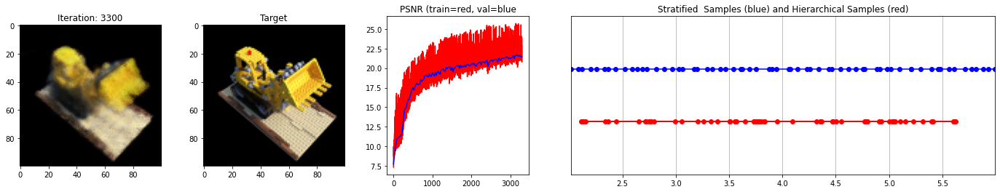

 33%|███▎      | 3325/10000 [20:28<39:08,  2.84it/s]

Loss: 0.006778182927519083


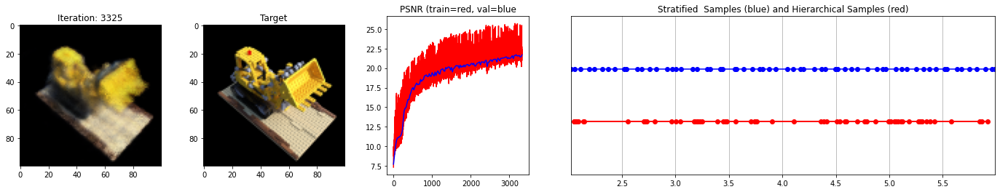

 34%|███▎      | 3350/10000 [20:38<41:09,  2.69it/s]

Loss: 0.0070047867484390736


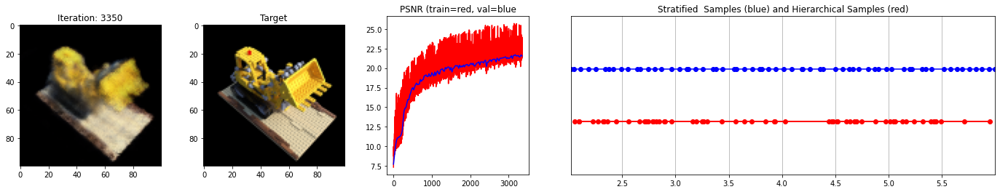

 34%|███▍      | 3375/10000 [20:48<38:16,  2.88it/s]

Loss: 0.00698111904785037


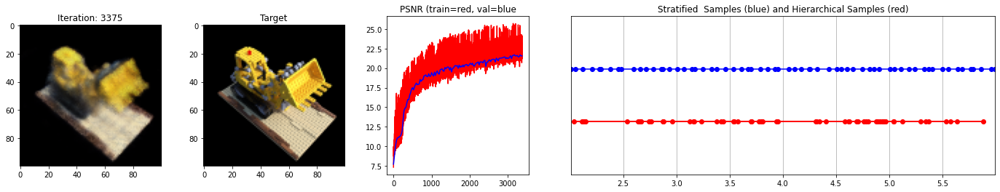

 34%|███▍      | 3400/10000 [20:57<38:05,  2.89it/s]

Loss: 0.006401308346539736


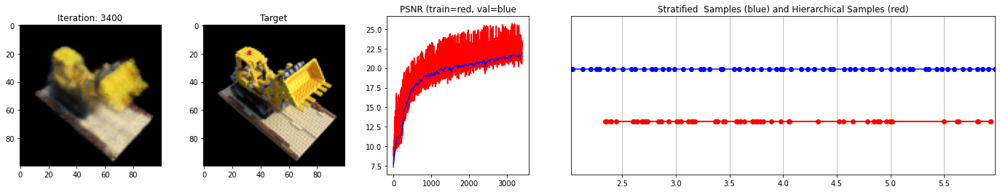

 34%|███▍      | 3425/10000 [21:07<37:58,  2.89it/s]

Loss: 0.006783496122807264


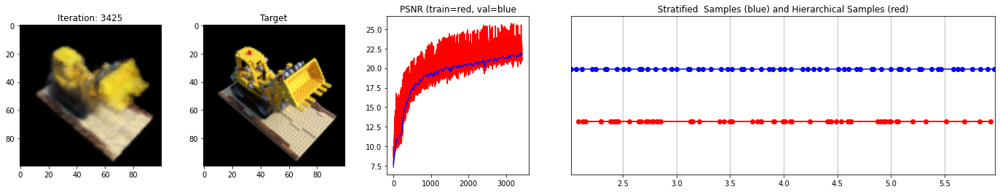

 34%|███▍      | 3450/10000 [21:16<37:49,  2.89it/s]

Loss: 0.006709528621286154


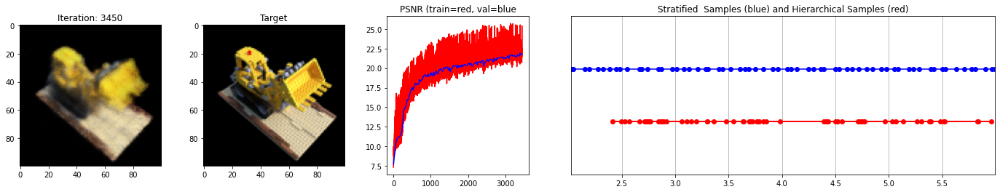

 35%|███▍      | 3475/10000 [21:25<37:37,  2.89it/s]

Loss: 0.006507317069917917


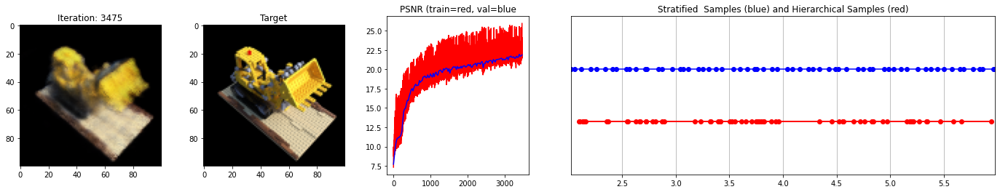

 35%|███▌      | 3500/10000 [21:35<37:23,  2.90it/s]

Loss: 0.006385255139321089


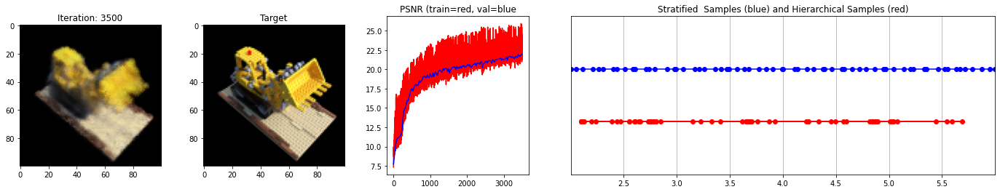

 35%|███▌      | 3525/10000 [21:44<37:23,  2.89it/s]

Loss: 0.00753855099901557


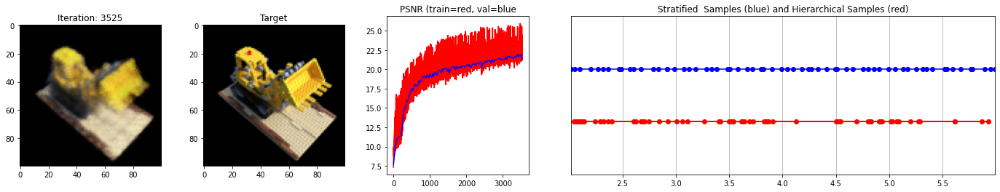

 36%|███▌      | 3550/10000 [21:54<37:20,  2.88it/s]

Loss: 0.006985234562307596


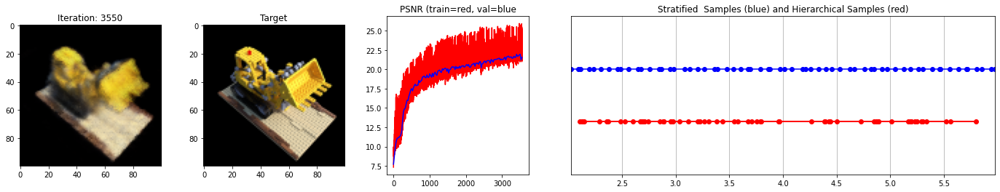

 36%|███▌      | 3575/10000 [22:03<37:07,  2.88it/s]

Loss: 0.007062010932713747


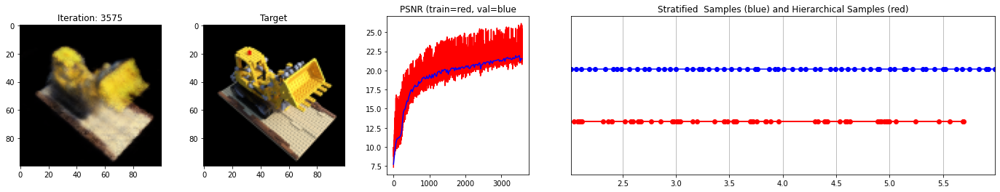

 36%|███▌      | 3600/10000 [22:12<36:51,  2.89it/s]

Loss: 0.007319182623177767


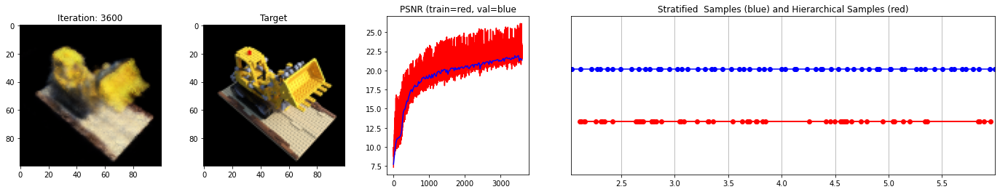

 36%|███▋      | 3625/10000 [22:22<36:40,  2.90it/s]

Loss: 0.0066686756908893585


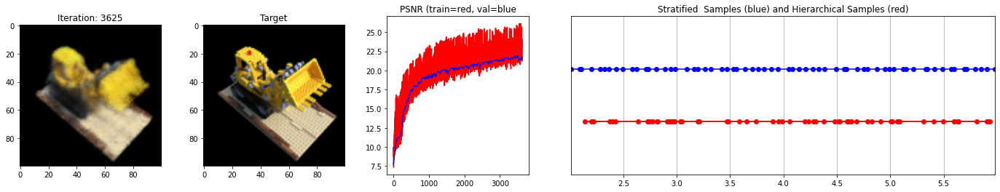

 36%|███▋      | 3650/10000 [22:31<36:31,  2.90it/s]

Loss: 0.0066535319201648235


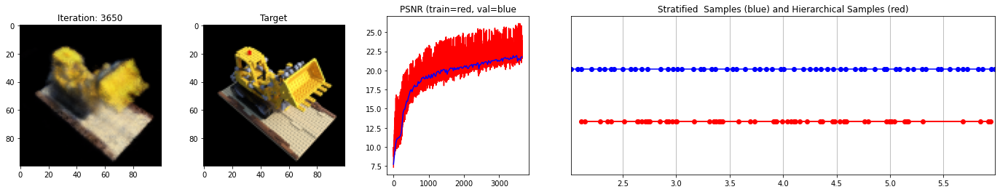

 37%|███▋      | 3675/10000 [22:40<36:25,  2.89it/s]

Loss: 0.006765672005712986


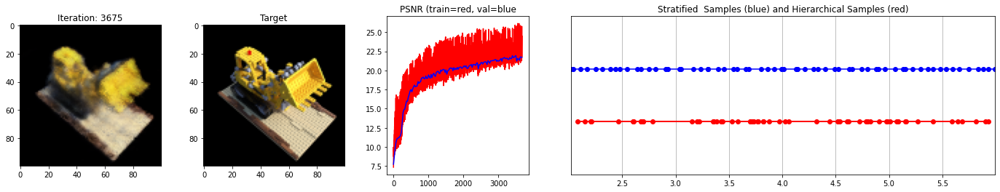

 37%|███▋      | 3700/10000 [22:50<36:21,  2.89it/s]

Loss: 0.006546396762132645


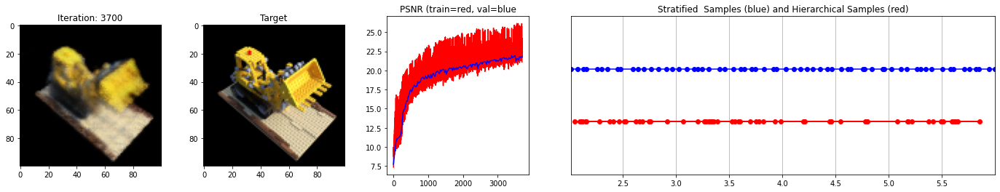

 37%|███▋      | 3725/10000 [22:59<36:17,  2.88it/s]

Loss: 0.0068472749553620815


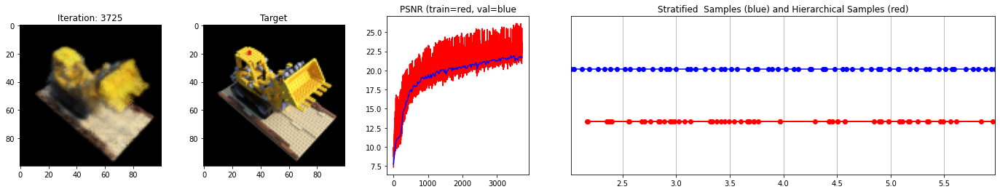

 38%|███▊      | 3750/10000 [23:09<36:02,  2.89it/s]

Loss: 0.006836448330432177


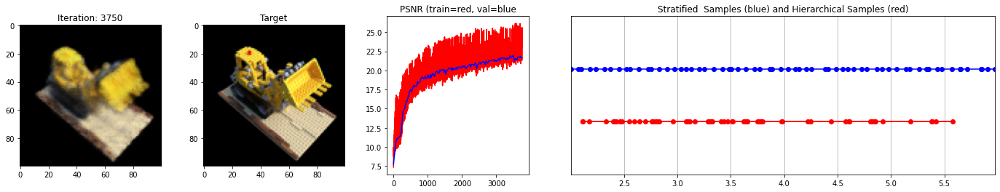

 38%|███▊      | 3775/10000 [23:18<35:54,  2.89it/s]

Loss: 0.006761461496353149


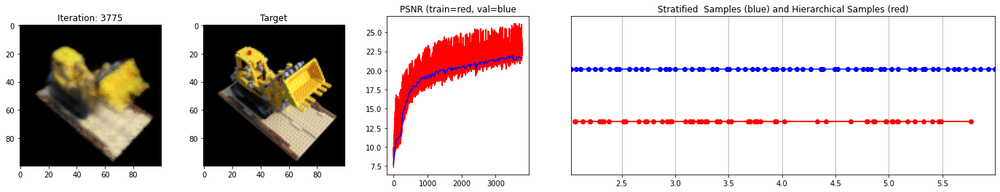

 38%|███▊      | 3800/10000 [23:27<35:40,  2.90it/s]

Loss: 0.006891052238643169


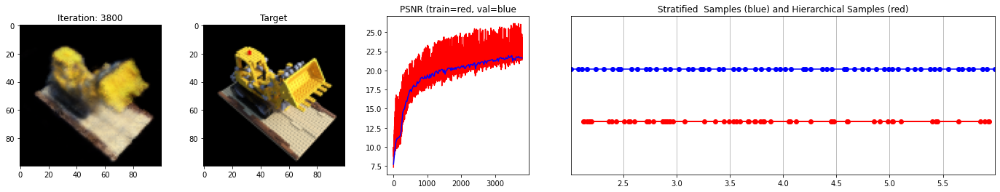

 38%|███▊      | 3825/10000 [23:37<35:41,  2.88it/s]

Loss: 0.006926932372152805


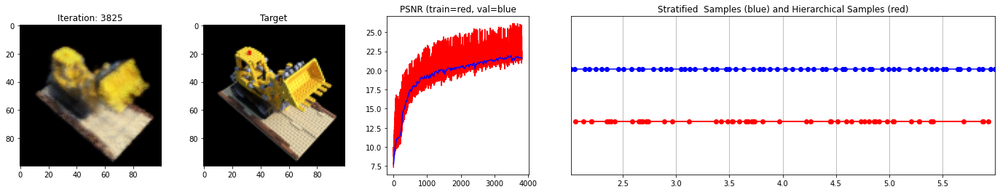

 38%|███▊      | 3850/10000 [23:46<35:25,  2.89it/s]

Loss: 0.007108346559107304


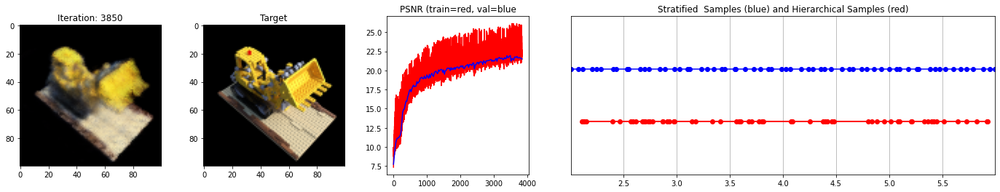

 39%|███▉      | 3875/10000 [23:55<35:14,  2.90it/s]

Loss: 0.006380558479577303


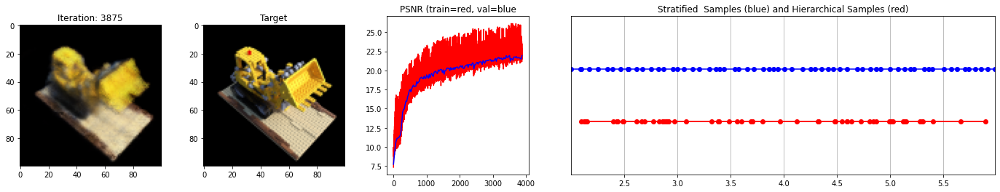

 39%|███▉      | 3900/10000 [24:05<35:00,  2.90it/s]

Loss: 0.006592461373656988


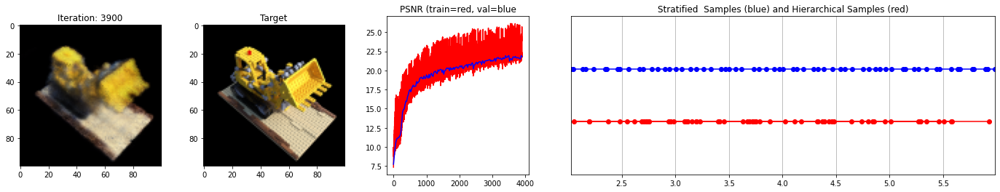

 39%|███▉      | 3925/10000 [24:14<34:58,  2.89it/s]

Loss: 0.006547201424837112


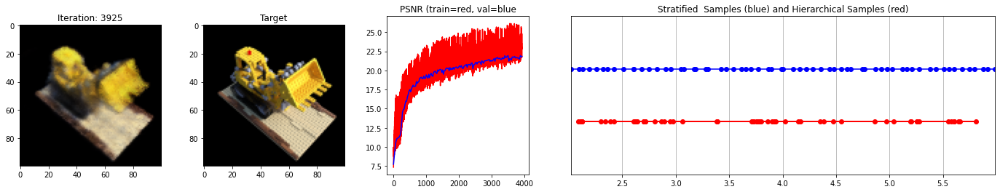

 40%|███▉      | 3950/10000 [24:24<34:55,  2.89it/s]

Loss: 0.0065228682942688465


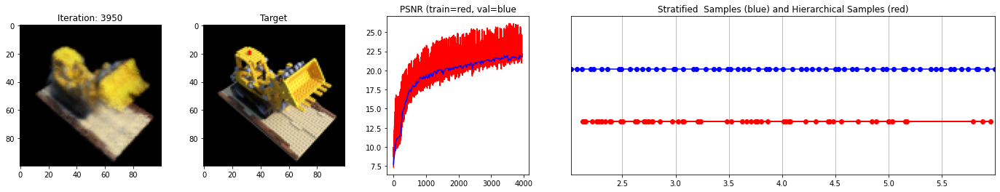

 40%|███▉      | 3975/10000 [24:33<34:38,  2.90it/s]

Loss: 0.006705286912620068


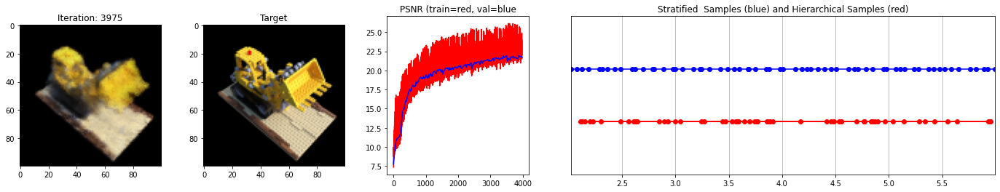

 40%|████      | 4000/10000 [24:42<34:36,  2.89it/s]

Loss: 0.006058461032807827


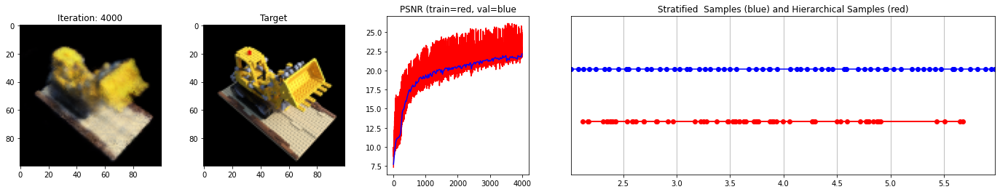

 40%|████      | 4025/10000 [24:52<34:34,  2.88it/s]

Loss: 0.007175748702138662


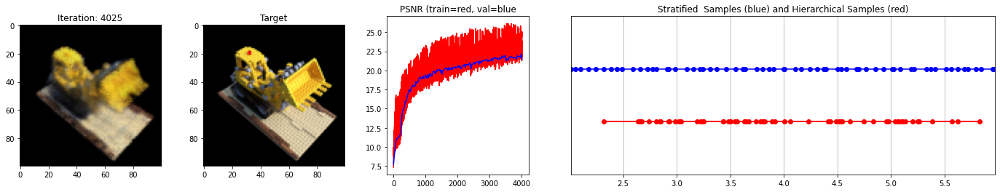

 40%|████      | 4050/10000 [25:01<34:18,  2.89it/s]

Loss: 0.006678124889731407


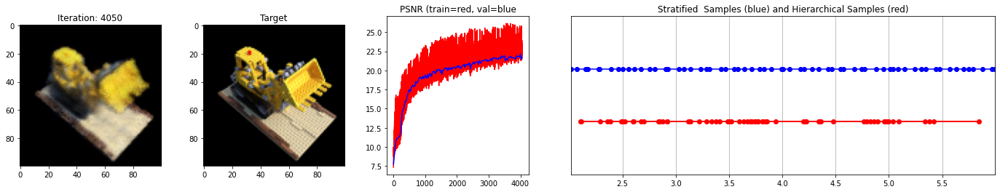

 41%|████      | 4075/10000 [25:10<34:01,  2.90it/s]

Loss: 0.0069479565136134624


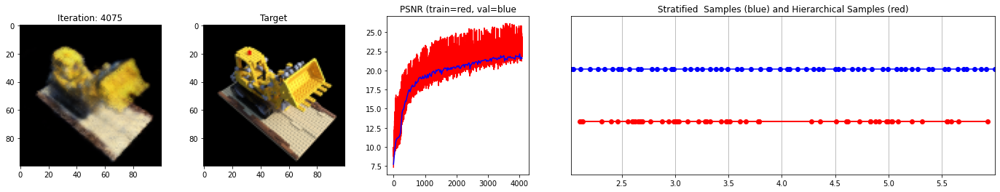

 41%|████      | 4100/10000 [25:20<34:01,  2.89it/s]

Loss: 0.006123436614871025


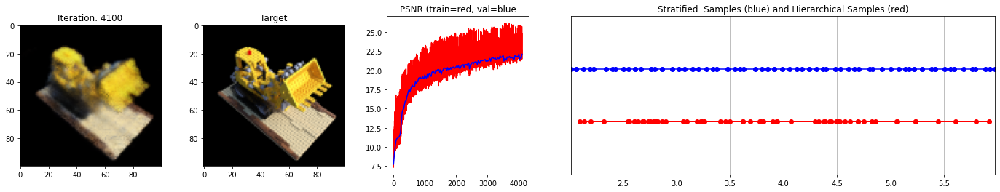

 41%|████▏     | 4125/10000 [25:29<33:50,  2.89it/s]

Loss: 0.005736870225518942


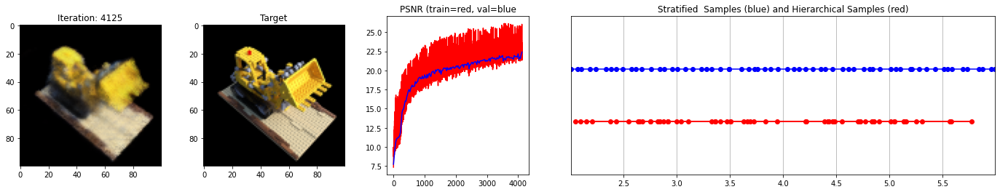

 42%|████▏     | 4150/10000 [25:39<33:39,  2.90it/s]

Loss: 0.006396708078682423


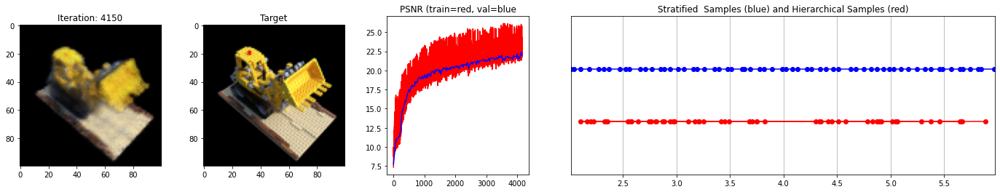

 42%|████▏     | 4175/10000 [25:48<33:28,  2.90it/s]

Loss: 0.006092088762670755


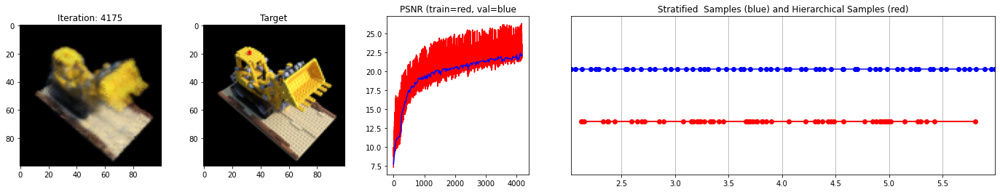

 42%|████▏     | 4200/10000 [25:57<33:17,  2.90it/s]

Loss: 0.00625293143093586


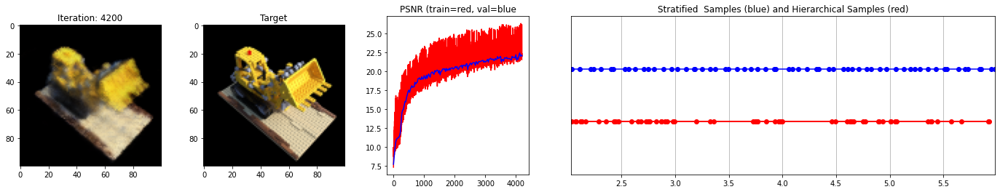

 42%|████▏     | 4225/10000 [26:07<33:14,  2.90it/s]

Loss: 0.005855464842170477


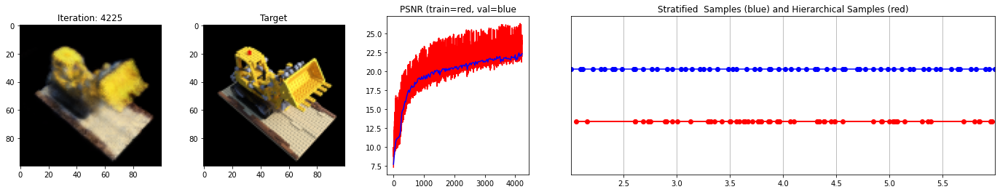

 42%|████▎     | 4250/10000 [26:16<33:21,  2.87it/s]

Loss: 0.0066167195327579975


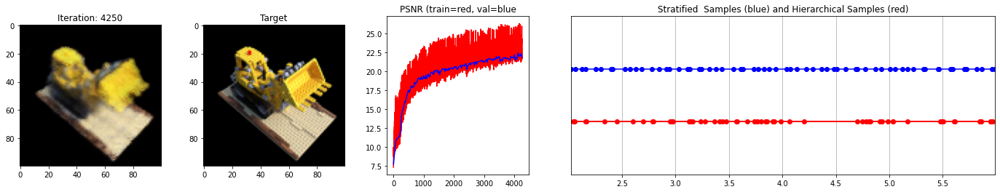

 43%|████▎     | 4275/10000 [26:26<33:01,  2.89it/s]

Loss: 0.005616770591586828


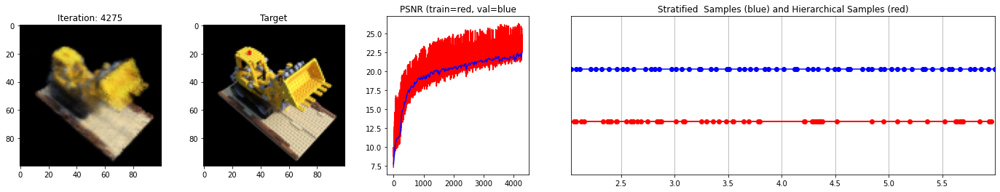

 43%|████▎     | 4300/10000 [26:35<32:50,  2.89it/s]

Loss: 0.006350184325128794


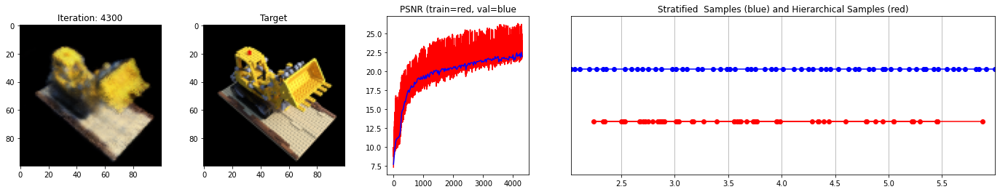

 43%|████▎     | 4325/10000 [26:44<32:44,  2.89it/s]

Loss: 0.006114720832556486


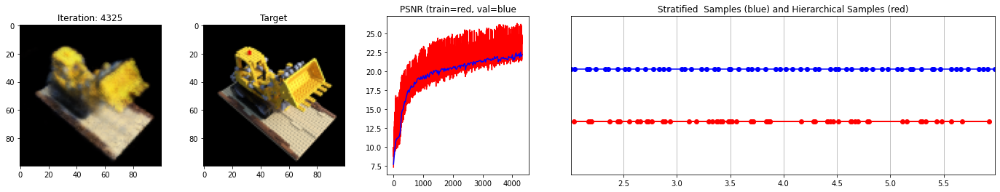

 44%|████▎     | 4350/10000 [26:54<32:33,  2.89it/s]

Loss: 0.006033110897988081


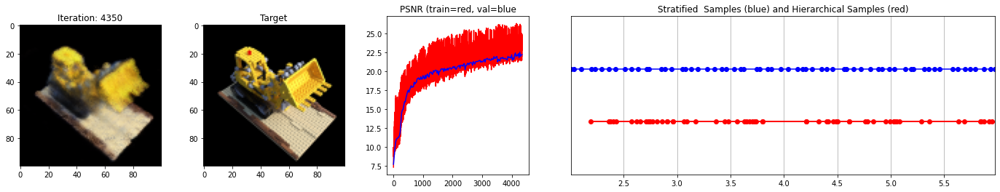

 44%|████▍     | 4375/10000 [27:03<32:39,  2.87it/s]

Loss: 0.006352304946631193


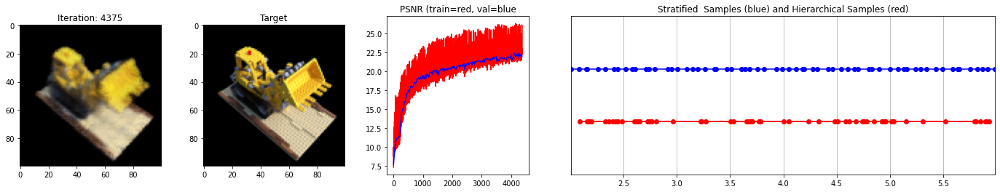

 44%|████▍     | 4400/10000 [27:13<32:12,  2.90it/s]

Loss: 0.0058574979193508625


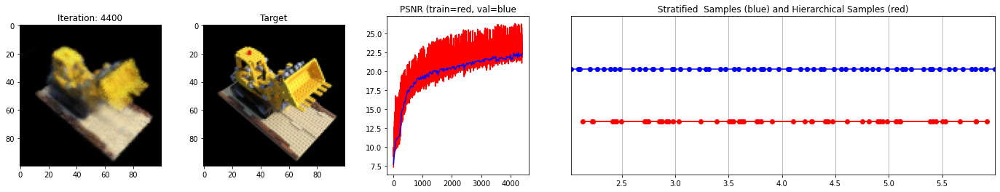

 44%|████▍     | 4425/10000 [27:22<32:07,  2.89it/s]

Loss: 0.00666182953864336


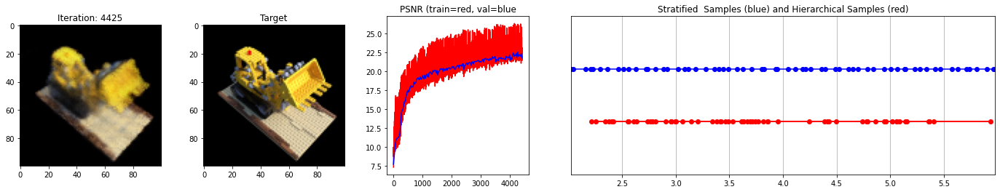

 44%|████▍     | 4450/10000 [27:31<31:55,  2.90it/s]

Loss: 0.00573090510442853


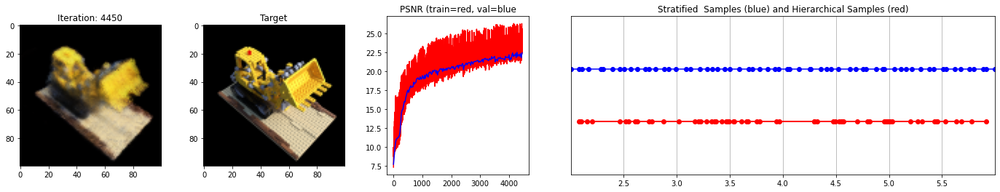

 45%|████▍     | 4475/10000 [27:41<31:54,  2.89it/s]

Loss: 0.005811039358377457


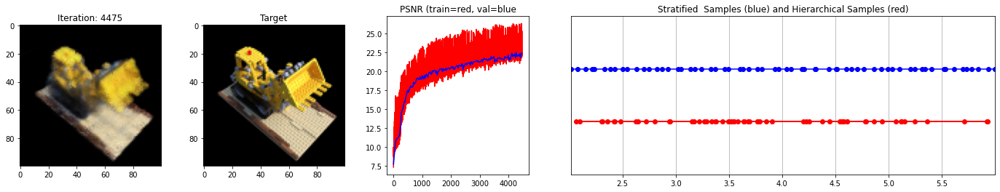

 45%|████▍     | 4483/10000 [27:44<33:53,  2.71it/s]

In [ ]:
# Run training session(s)
for _ in range(n_restarts):
  model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()
  success, train_psnrs, val_psnrs = train()
  if success and val_psnrs[-1] >= warmup_min_fitness:
    print('Training successful!')
    break

print('')
print(f'Done!')